In [2]:
#standard library
import os
import math
import random
import shutil
import warnings

# Third-party libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg
from PIL import Image
from sklearn.model_selection import train_test_split
import cv2
import matplotlib.patches as patches

In [148]:
import logging
logging.getLogger('matplotlib.font_manager').disabled = True

In [3]:
bird_dir = pd.read_csv('data/images.txt' , header = None , sep= ' ') 
bird_dir.columns = ['image_id' , 'image_dir']

In [4]:
bird_dir.head()

,image_id,image_dir
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...


In [5]:
class_name = pd.read_csv('data/classes.txt' , header = None , sep= ' ') 
class_name.columns = ['class_id' , 'class_name']

In [6]:
class_name

,class_id,class_name
0,1,001.Black_footed_Albatross
1,2,002.Laysan_Albatross
2,3,003.Sooty_Albatross
3,4,004.Groove_billed_Ani
4,5,005.Crested_Auklet
...,...,...
195,196,196.House_Wren
196,197,197.Marsh_Wren
197,198,198.Rock_Wren
198,199,199.Winter_Wren


In [7]:
def split_first_whitespace(line):
    parts = line.split(maxsplit=1)
    return parts

In [8]:
with open('data/parts.txt', 'r') as file:
    lines = file.readlines()
    parts_data = [split_first_whitespace(line.strip()) for line in lines]

In [9]:
parts_data

[['1', 'back'],
 ['2', 'beak'],
 ['3', 'belly'],
 ['4', 'barest'],
 ['5', 'crown'],
 ['6', 'forehead'],
 ['7', 'left eye'],
 ['8', 'left leg'],
 ['9', 'left wing'],
 ['10', 'nape'],
 ['11', 'right eye'],
 ['12', 'right leg'],
 ['13', 'right wing'],
 ['14', 'tail'],
 ['15', 'throat']]

In [10]:
parts_name = pd.DataFrame(parts_data, columns=['part_id', 'part_name'])

In [11]:
parts_name

,part_id,part_name
0,1,back
1,2,beak
2,3,belly
3,4,barest
4,5,crown
5,6,forehead
6,7,left eye
7,8,left leg
8,9,left wing
9,10,nape


In [12]:
parts_loc = pd.read_csv('data/part_locs.txt' , header = None , sep= ' ') 

In [13]:
parts_loc.columns = ['image_id' , 'part_id' , 'X_part' , 'Y_part' , 'visible']

In [14]:
parts_loc

,image_id,part_id,X_part,Y_part,visible
0,1,1,0.0,0.0,0
1,1,2,312.0,182.0,1
2,1,3,0.0,0.0,0
3,1,4,0.0,0.0,0
4,1,5,186.0,45.0,1
...,...,...,...,...,...
176815,11788,11,136.0,133.0,1
176816,11788,12,102.0,316.0,1
176817,11788,13,94.0,224.0,1
176818,11788,14,36.0,329.0,1


# The class for each Bird 

In [15]:
bird_class = pd.read_csv('data/image_class_labels.txt' , header = None , sep= ' ')
bird_class.columns = ['image_id' , 'class_id']

In [16]:
bird_class

,image_id,class_id
0,1,1
1,2,1
2,3,1
3,4,1
4,5,1
...,...,...
11783,11784,200
11784,11785,200
11785,11786,200
11786,11787,200


# attributes_ dataset 

In [17]:
attributes_name = pd.read_csv('data/attributes.txt' , header = None , sep= ' ') 

In [18]:
attributes_name.columns = ['attribute_id' , 'attributes_name']

In [19]:
attributes_name['attributes_name'].unique()

array(['has_bill_shape::curved_(up_or_down)', 'has_bill_shape::dagger',
       'has_bill_shape::hooked', 'has_bill_shape::needle',
       'has_bill_shape::hooked_seabird', 'has_bill_shape::spatulate',
       'has_bill_shape::all-purpose', 'has_bill_shape::cone',
       'has_bill_shape::specialized', 'has_wing_color::blue',
       'has_wing_color::brown', 'has_wing_color::iridescent',
       'has_wing_color::purple', 'has_wing_color::rufous',
       'has_wing_color::grey', 'has_wing_color::yellow',
       'has_wing_color::olive', 'has_wing_color::green',
       'has_wing_color::pink', 'has_wing_color::orange',
       'has_wing_color::black', 'has_wing_color::white',
       'has_wing_color::red', 'has_wing_color::buff',
       'has_upperparts_color::blue', 'has_upperparts_color::brown',
       'has_upperparts_color::iridescent', 'has_upperparts_color::purple',
       'has_upperparts_color::rufous', 'has_upperparts_color::grey',
       'has_upperparts_color::yellow', 'has_upperparts_color

In [20]:
with open('data/certainties.txt', 'r') as file:
    lines = file.readlines()
    certainty_data = [split_first_whitespace(line.strip()) for line in lines]

In [21]:
certainty_data

[['1', 'not visible'],
 ['2', 'guessing'],
 ['3', 'probably'],
 ['4', 'definitely']]

In [22]:
certainty_id = pd.DataFrame(certainty_data , columns= ['certainty_id' , 'certainty_name'])

In [23]:
certainty_id

,certainty_id,certainty_name
0,1,not visible
1,2,guessing
2,3,probably
3,4,definitely


In [24]:
with open('data/image_attribute_labels.txt', 'r') as file:
    lines = file.readlines()
    attribute_data = [line.strip().split()  for line in lines] 

In [25]:
attribute_data

[['1', '1', '0', '3', '27.7080'],
 ['1', '2', '0', '3', '27.7080'],
 ['1', '3', '0', '3', '27.7080'],
 ['1', '4', '0', '3', '27.7080'],
 ['1', '5', '1', '3', '27.7080'],
 ['1', '6', '0', '3', '27.7080'],
 ['1', '7', '0', '3', '27.7080'],
 ['1', '8', '0', '3', '27.7080'],
 ['1', '9', '0', '3', '27.7080'],
 ['1', '10', '0', '1', '1.7040'],
 ['1', '11', '0', '1', '1.7040'],
 ['1', '12', '0', '1', '1.7040'],
 ['1', '13', '0', '1', '1.7040'],
 ['1', '14', '0', '1', '1.7040'],
 ['1', '15', '0', '1', '1.7040'],
 ['1', '16', '0', '1', '1.7040'],
 ['1', '17', '0', '1', '1.7040'],
 ['1', '18', '0', '1', '1.7040'],
 ['1', '19', '0', '1', '1.7040'],
 ['1', '20', '0', '1', '1.7040'],
 ['1', '21', '0', '1', '1.7040'],
 ['1', '22', '0', '1', '1.7040'],
 ['1', '23', '0', '1', '1.7040'],
 ['1', '24', '0', '1', '1.7040'],
 ['1', '25', '0', '1', '1.7660'],
 ['1', '26', '0', '1', '1.7660'],
 ['1', '27', '0', '1', '1.7660'],
 ['1', '28', '0', '1', '1.7660'],
 ['1', '29', '0', '1', '1.7660'],
 ['1', '30', '

In [26]:
bird_attribute = pd.DataFrame(attribute_data , columns= ['image_id' , 'attribute_id' , 'is_present' , 'certainty_id' , 'time' ,'col6'])

In [27]:
bird_attribute

,image_id,attribute_id,is_present,certainty_id,time,col6
0,1,1,0,3,27.7080,None
1,1,2,0,3,27.7080,None
2,1,3,0,3,27.7080,None
3,1,4,0,3,27.7080,None
4,1,5,1,3,27.7080,None
...,...,...,...,...,...,...
3677851,11788,308,1,4,4.9890,None
3677852,11788,309,0,4,8.3090,None
3677853,11788,310,0,4,8.3090,None
3677854,11788,311,0,4,8.3090,None


In [28]:
bird_attribute['col6'].unique()

array([None, '1.509', '3.989', '10.118', '4.109', '2.431', '5.032',
       '7.278', '4.718', '4.590', '3.237', '3.872', '6.470', '12.184',
       '2.679', '3.973', '4.950', '2.710', '3.637', '3.143', '1.319',
       '8.541', '8.766', '8.086', '8.031', '9.581', '2.973', '2.975',
       '3.535', '3.564', '2.916', '4.030', '3.767', '10.925', '3.035',
       '8.295', '3.559', '4.324', '3.269', '5.852', '3.181', '6.119',
       '3.109', '3.391', '9.917', '2.501', '5.452', '5.999', '5.288',
       '3.462', '11.670', '12.581', '5.115', '13.288', '6.240'],
      dtype=object)

In [29]:
with open('data/bounding_boxes.txt', 'r') as file:
    lines = file.readlines()
    bounding_boxes_data = [line.strip().split()  for line in lines] 

In [30]:
bounding_boxes_data

[['1', '60.0', '27.0', '325.0', '304.0'],
 ['2', '139.0', '30.0', '153.0', '264.0', '292', '417'],
 ['3', '14.0', '112.0', '388.0', '186.0'],
 ['4', '112.0', '90.0', '255.0', '242.0'],
 ['5', '70.0', '50.0', '134.0', '303.0'],
 ['6', '33.0', '53.0', '251.0', '395.0'],
 ['7', '7.0', '75.0', '420.0', '262.0'],
 ['8', '78.0', '86.0', '333.0', '158.0'],
 ['9', '112.0', '76.0', '221.0', '189.0'],
 ['10', '27.0', '4.0', '199.0', '201.0'],
 ['11', '1.0', '52.0', '342.0', '260.0'],
 ['12', '47.0', '21.0', '179.0', '249.0'],
 ['13', '36.0', '32.0', '197.0', '457.0'],
 ['14', '37.0', '40.0', '262.0', '184.0'],
 ['15', '23.0', '80.0', '395.0', '237.0'],
 ['16', '141.0', '87.0', '256.0', '211.0'],
 ['17', '40.0', '38.0', '254.0', '209.0'],
 ['18', '45.0', '58.0', '254.0', '249.0'],
 ['19', '135.0', '83.0', '304.0', '181.0'],
 ['20', '23.0', '195.0', '255.0', '122.0'],
 ['21', '11.0', '77.0', '281.0', '139.0'],
 ['22', '5.0', '4.0', '210.0', '130.0'],
 ['23', '154.0', '93.0', '188.0', '165.0'],
 ['

In [31]:
bounding_boxes = pd.DataFrame(bounding_boxes_data , columns= ['image_id' , 'X_bound_box' , 'Y_bound_box' , 'width' , 'height' , 'col1' , 'col2'])

In [32]:
bounding_boxes

,image_id,X_bound_box,Y_bound_box,width,height,col1,col2
0,1,60.0,27.0,325.0,304.0,None,None
1,2,139.0,30.0,153.0,264.0,292,417
2,3,14.0,112.0,388.0,186.0,None,None
3,4,112.0,90.0,255.0,242.0,None,None
4,5,70.0,50.0,134.0,303.0,None,None
...,...,...,...,...,...,...,...
11783,11784,89.0,95.0,354.0,250.0,None,None
11784,11785,157.0,62.0,184.0,219.0,None,None
11785,11786,190.0,102.0,198.0,202.0,None,None
11786,11787,3.0,20.0,408.0,307.0,None,None


In [33]:
bounding_boxes['col2'].count()

1

# Merge all data set into one ( bird_2019.csv)

In [35]:
dfs = [bird_dir, bird_class, parts_loc, bird_attribute, bounding_boxes]
for df in dfs:
    df['image_id'] = df['image_id'].astype(str)

In [36]:
bird_merged_data = pd.merge(bird_dir ,bird_class , on = 'image_id')

In [38]:
bird_merged_data

,image_id,image_dir,class_id
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1
...,...,...,...
11783,11784,200.Common_Yellowthroat/Common_Yellowthroat_00...,200
11784,11785,200.Common_Yellowthroat/Common_Yellowthroat_00...,200
11785,11786,200.Common_Yellowthroat/Common_Yellowthroat_00...,200
11786,11787,200.Common_Yellowthroat/Common_Yellowthroat_00...,200


# Add the class_name col

In [41]:
bird_merged_data = pd.merge(bird_merged_data, class_name, on='class_id', how='left')

In [42]:
bird_merged_data

,image_id,image_dir,class_id,class_name_x,class_name_y
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,001.Black_footed_Albatross
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,001.Black_footed_Albatross
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,001.Black_footed_Albatross
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,001.Black_footed_Albatross
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,001.Black_footed_Albatross
...,...,...,...,...,...
11783,11784,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,200.Common_Yellowthroat
11784,11785,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,200.Common_Yellowthroat
11785,11786,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,200.Common_Yellowthroat
11786,11787,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,200.Common_Yellowthroat


# Merge Part Datasets

In [43]:
part_dfs = [parts_loc, parts_name ]
for df in part_dfs:
    df['part_id'] = df['part_id'].astype(str)

In [44]:
parts_merged_data = pd.merge(parts_loc, parts_name, on='part_id', how='left')

In [45]:
parts_merged_data

,image_id,part_id,X_part,Y_part,visible,part_name
0,1,1,0.0,0.0,0,back
1,1,2,312.0,182.0,1,beak
2,1,3,0.0,0.0,0,belly
3,1,4,0.0,0.0,0,barest
4,1,5,186.0,45.0,1,crown
...,...,...,...,...,...,...
176815,11788,11,136.0,133.0,1,right eye
176816,11788,12,102.0,316.0,1,right leg
176817,11788,13,94.0,224.0,1,right wing
176818,11788,14,36.0,329.0,1,tail


In [46]:
parts_merged_data['part_locations'] = parts_merged_data.apply(lambda row: {
    'X_part': row['X_part'],
    'Y_part': row['Y_part'],
    'visible': row['visible']
}, axis=1)

In [47]:
parts_merged_data.drop(columns=['X_part','Y_part','visible'], inplace = True)

In [48]:
pivoted_parts_merged_data = parts_merged_data.pivot_table(index='image_id', columns='part_name', values = 'part_locations' ,  aggfunc='first').reset_index()

In [49]:
pivoted_parts_merged_data.head()

part_name,image_id,back,barest,beak,belly,crown,forehead,left eye,left leg,left wing,nape,right eye,right leg,right wing,tail,throat
0,1,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 100.0, 'Y_part': 221.0, 'visible': 1}","{'X_part': 183.0, 'Y_part': 101.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 215.0, 'Y_part': 194.0, 'visible': 1}"
1,10,"{'X_part': 117.0, 'Y_part': 103.0, 'visible': 1}","{'X_part': 64.0, 'Y_part': 118.0, 'visible': 1}","{'X_part': 52.0, 'Y_part': 40.0, 'visible': 1}","{'X_part': 80.0, 'Y_part': 155.0, 'visible': 1}","{'X_part': 84.0, 'Y_part': 13.0, 'visible': 1}","{'X_part': 69.0, 'Y_part': 19.0, 'visible': 1}","{'X_part': 81.0, 'Y_part': 23.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 140.0, 'Y_part': 139.0, 'visible': 1}","{'X_part': 101.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 199.0, 'Y_part': 178.0, 'visible': 1}","{'X_part': 77.0, 'Y_part': 52.0, 'visible': 1}"
2,100,"{'X_part': 269.0, 'Y_part': 183.0, 'visible': 1}","{'X_part': 213.0, 'Y_part': 170.0, 'visible': 1}","{'X_part': 172.0, 'Y_part': 153.0, 'visible': 1}","{'X_part': 233.0, 'Y_part': 254.0, 'visible': 1}","{'X_part': 204.0, 'Y_part': 116.0, 'visible': 1}","{'X_part': 186.0, 'Y_part': 119.0, 'visible': 1}","{'X_part': 186.0, 'Y_part': 128.0, 'visible': 1}","{'X_part': 295.0, 'Y_part': 283.0, 'visible': 1}","{'X_part': 189.0, 'Y_part': 187.0, 'visible': 1}","{'X_part': 223.0, 'Y_part': 152.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 350.0, 'Y_part': 163.0, 'visible': 1}","{'X_part': 356.0, 'Y_part': 246.0, 'visible': 1}","{'X_part': 211.0, 'Y_part': 155.0, 'visible': 1}"
3,1000,"{'X_part': 300.0, 'Y_part': 111.0, 'visible': 1}","{'X_part': 261.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 221.0, 'Y_part': 91.0, 'visible': 1}","{'X_part': 286.0, 'Y_part': 172.0, 'visible': 1}","{'X_part': 261.0, 'Y_part': 79.0, 'visible': 1}","{'X_part': 238.0, 'Y_part': 84.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 90.0, 'visible': 1}","{'X_part': 318.0, 'Y_part': 197.0, 'visible': 1}","{'X_part': 312.0, 'Y_part': 136.0, 'visible': 1}","{'X_part': 286.0, 'Y_part': 102.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 374.0, 'Y_part': 245.0, 'visible': 1}","{'X_part': 243.0, 'Y_part': 109.0, 'visible': 1}"
4,10000,"{'X_part': 124.0, 'Y_part': 133.0, 'visible': 1}","{'X_part': 242.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 246.0, 'Y_part': 91.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 234.0, 'visible': 1}","{'X_part': 198.0, 'Y_part': 66.0, 'visible': 1}","{'X_part': 228.0, 'Y_part': 80.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 164.0, 'Y_part': 115.0, 'visible': 1}","{'X_part': 191.0, 'Y_part': 98.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 116.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 238.0, 'Y_part': 126.0, 'visible': 1}"


In [33]:
pivoted_parts_merged_data.index

RangeIndex(start=0, stop=11788, step=1)

# Merge the Bird data and parts data 

In [74]:
for df in [bird_merged_data, pivoted_parts_merged_data ]:
    df['image_id'] = df['image_id'].astype(str)
Bird_merged_data = pd.merge(bird_merged_data, pivoted_parts_merged_data, on='image_id', how='left')

In [75]:
bird_merged_data.head()

,image_id,image_dir,class_id,class_name,back,barest,beak,belly,crown,forehead,left eye,left leg,left wing,nape,right eye,right leg,right wing,tail,throat
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 100.0, 'Y_part': 221.0, 'visible': 1}","{'X_part': 183.0, 'Y_part': 101.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 215.0, 'Y_part': 194.0, 'visible': 1}"
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 228.0, 'Y_part': 138.0, 'visible': 1}","{'X_part': 248.0, 'Y_part': 158.0, 'visible': 1}","{'X_part': 282.0, 'Y_part': 154.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 266.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 272.0, 'Y_part': 144.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 208.0, 'Y_part': 102.0, 'visible': 1}","{'X_part': 256.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 270.0, 'Y_part': 146.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 234.0, 'Y_part': 193.0, 'visible': 1}","{'X_part': 163.0, 'Y_part': 155.0, 'visible': 1}","{'X_part': 260.0, 'Y_part': 155.0, 'visible': 1}"
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 227.0, 'Y_part': 213.0, 'visible': 1}","{'X_part': 325.0, 'Y_part': 243.0, 'visible': 1}","{'X_part': 376.0, 'Y_part': 160.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 324.0, 'Y_part': 121.0, 'visible': 1}","{'X_part': 349.0, 'Y_part': 128.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 170.0, 'Y_part': 198.0, 'visible': 1}","{'X_part': 288.0, 'Y_part': 169.0, 'visible': 1}","{'X_part': 336.0, 'Y_part': 136.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 199.0, 'Y_part': 237.0, 'visible': 1}","{'X_part': 42.0, 'Y_part': 201.0, 'visible': 1}","{'X_part': 327.0, 'Y_part': 174.0, 'visible': 1}"
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 221.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 215.0, 'visible': 1}","{'X_part': 126.0, 'Y_part': 203.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 157.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 145.0, 'Y_part': 187.0, 'visible': 1}","{'X_part': 153.0, 'Y_part': 189.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 238.0, 'Y_part': 245.0, 'visible': 1}","{'X_part': 182.0, 'Y_part': 183.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 235.0, 'Y_part': 133.0, 'visible': 1}","{'X_part': 337.0, 'Y_part': 211.0, 'visible': 1}","{'X_part': 174.0, 'Y_part': 207.0, 'visible': 1}"
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 154.0, 'Y_part': 153.0, 'visible': 1}","{'X_part': 194.0, 'Y_part': 147.0, 'visible': 1}","{'X_part': 132.0, 'Y_part': 159.0, 'visible': 1}","{'X_part': 177.0, 'Y_part': 137.0, 'visible': 1}","{'X_part': 183.0, 'Y_part': 139.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 137.0, 'Y_part': 203.0, 'visible': 1}","{'X_part':

# Merge Attributes Datasets

In [77]:
bird_attribute.head()

,image_id,attribute_id,is_present,certainty_id,time,col6
0,1,1,0,3,27.7080,None
1,1,2,0,3,27.7080,None
2,1,3,0,3,27.7080,None
3,1,4,0,3,27.7080,None
4,1,5,1,3,27.7080,None


In [79]:
missing_percentages_in_col6 = bird_attribute['col6'].isnull().mean() * 100
print(missing_percentages_in_col6)

99.98352300905745


In [80]:
# Drop the col. 
bird_attribute.drop(columns='col6' , inplace = True )

In [89]:
bird_attribute.head()

,image_id,attribute_id,is_present,certainty_id,time
0,1,1,0,3,27.7080
1,1,2,0,3,27.7080
2,1,3,0,3,27.7080
3,1,4,0,3,27.7080
4,1,5,1,3,27.7080


In [134]:
attributes_name

,attribute_id,attributes_name
0,1,has_bill_shape::curved_(up_or_down)
1,2,has_bill_shape::dagger
2,3,has_bill_shape::hooked
3,4,has_bill_shape::needle
4,5,has_bill_shape::hooked_seabird
...,...,...
307,308,has_crown_color::buff
308,309,has_wing_pattern::solid
309,310,has_wing_pattern::spotted
310,311,has_wing_pattern::striped


In [104]:
for df in [bird_attribute, attributes_name ]:
    df['attribute_id'] = df['attribute_id'].astype(str)
attributes_merged_data = pd.merge(bird_attribute, attributes_name, on='attribute_id', how='left')

In [105]:
attributes_merged_data.head()

,image_id,attribute_id,is_present,certainty_id,time,attributes_name
0,1,1,0,3,27.7080,has_bill_shape::curved_(up_or_down)
1,1,2,0,3,27.7080,has_bill_shape::dagger
2,1,3,0,3,27.7080,has_bill_shape::hooked
3,1,4,0,3,27.7080,has_bill_shape::needle
4,1,5,1,3,27.7080,has_bill_shape::hooked_seabird


# Add certainty Values 

In [106]:
for df in [attributes_merged_data, certainty_id ]:
    df['certainty_id'] = df['certainty_id'].astype(str)
attributes_merged_data = pd.merge(attributes_merged_data, certainty_id, on='certainty_id', how='left')

In [107]:
attributes_merged_data.head()

,image_id,attribute_id,is_present,certainty_id,time,attributes_name,certainty_name
0,1,1,0,3,27.7080,has_bill_shape::curved_(up_or_down),probably
1,1,2,0,3,27.7080,has_bill_shape::dagger,probably
2,1,3,0,3,27.7080,has_bill_shape::hooked,probably
3,1,4,0,3,27.7080,has_bill_shape::needle,probably
4,1,5,1,3,27.7080,has_bill_shape::hooked_seabird,probably


In [108]:
attributes_merged_data['attribute_present'] = attributes_merged_data.apply(lambda row: {
    'is_present': row['is_present'],
    'certainty': row['certainty_name'],}, axis=1)

In [109]:
attributes_merged_data.head()

,image_id,attribute_id,is_present,certainty_id,time,attributes_name,certainty_name,attribute_present
0,1,1,0,3,27.7080,has_bill_shape::curved_(up_or_down),probably,"{'is_present': '0', 'certainty': 'probably'}"
1,1,2,0,3,27.7080,has_bill_shape::dagger,probably,"{'is_present': '0', 'certainty': 'probably'}"
2,1,3,0,3,27.7080,has_bill_shape::hooked,probably,"{'is_present': '0', 'certainty': 'probably'}"
3,1,4,0,3,27.7080,has_bill_shape::needle,probably,"{'is_present': '0', 'certainty': 'probably'}"
4,1,5,1,3,27.7080,has_bill_shape::hooked_seabird,probably,"{'is_present': '1', 'certainty': 'probably'}"


In [110]:
attributes_merged_data.drop(columns=['is_present','certainty_id' , 'certainty_name' , 'time' ], inplace = True)

In [121]:
attributes_merged_data.head()

,image_id,attribute_id,attributes_name,attribute_present
0,1,1,has_bill_shape::curved_(up_or_down),"{'is_present': '0', 'certainty': 'probably'}"
1,1,2,has_bill_shape::dagger,"{'is_present': '0', 'certainty': 'probably'}"
2,1,3,has_bill_shape::hooked,"{'is_present': '0', 'certainty': 'probably'}"
3,1,4,has_bill_shape::needle,"{'is_present': '0', 'certainty': 'probably'}"
4,1,5,has_bill_shape::hooked_seabird,"{'is_present': '1', 'certainty': 'probably'}"


In [119]:
attributes_merged_data['image_id'].unique()

array(['1', '2', '3', ..., '11786', '11787', '11788'], dtype=object)

In [123]:
attributes_merged_data['image_id'] = pd.to_numeric(attributes_merged_data['image_id'], errors='coerce')

In [124]:
pivoted_attributes_merged_data = attributes_merged_data.pivot_table(index='image_id', columns='attributes_name', values ='attribute_present',aggfunc='first').reset_index()

In [125]:
pivoted_attributes_merged_data['image_id'].unique()

array([    1,     2,     3, ..., 11786, 11787, 11788], dtype=int64)

In [126]:
pivoted_attributes_merged_data.head()

attributes_name,image_id,has_back_color::black,has_back_color::blue,has_back_color::brown,has_back_color::buff,has_back_color::green,has_back_color::grey,has_back_color::iridescent,has_back_color::olive,has_back_color::orange,...,has_wing_color::yellow,has_wing_pattern::multi-colored,has_wing_pattern::solid,has_wing_pattern::spotted,has_wing_pattern::striped,has_wing_shape::broad-wings,has_wing_shape::long-wings,has_wing_shape::pointed-wings,has_wing_shape::rounded-wings,has_wing_shape::tapered-wings
0,1,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}"
1,2,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}"
2,3,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",...,"{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '1', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}"
3,4,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0'

# Merge attributes with Bird data 

In [127]:
bird_merged_data.head()

,image_id,image_dir,class_id,class_name,back,barest,beak,belly,crown,forehead,left eye,left leg,left wing,nape,right eye,right leg,right wing,tail,throat
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 100.0, 'Y_part': 221.0, 'visible': 1}","{'X_part': 183.0, 'Y_part': 101.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 215.0, 'Y_part': 194.0, 'visible': 1}"
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 228.0, 'Y_part': 138.0, 'visible': 1}","{'X_part': 248.0, 'Y_part': 158.0, 'visible': 1}","{'X_part': 282.0, 'Y_part': 154.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 266.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 272.0, 'Y_part': 144.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 208.0, 'Y_part': 102.0, 'visible': 1}","{'X_part': 256.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 270.0, 'Y_part': 146.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 234.0, 'Y_part': 193.0, 'visible': 1}","{'X_part': 163.0, 'Y_part': 155.0, 'visible': 1}","{'X_part': 260.0, 'Y_part': 155.0, 'visible': 1}"
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 227.0, 'Y_part': 213.0, 'visible': 1}","{'X_part': 325.0, 'Y_part': 243.0, 'visible': 1}","{'X_part': 376.0, 'Y_part': 160.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 324.0, 'Y_part': 121.0, 'visible': 1}","{'X_part': 349.0, 'Y_part': 128.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 170.0, 'Y_part': 198.0, 'visible': 1}","{'X_part': 288.0, 'Y_part': 169.0, 'visible': 1}","{'X_part': 336.0, 'Y_part': 136.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 199.0, 'Y_part': 237.0, 'visible': 1}","{'X_part': 42.0, 'Y_part': 201.0, 'visible': 1}","{'X_part': 327.0, 'Y_part': 174.0, 'visible': 1}"
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 221.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 215.0, 'visible': 1}","{'X_part': 126.0, 'Y_part': 203.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 157.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 145.0, 'Y_part': 187.0, 'visible': 1}","{'X_part': 153.0, 'Y_part': 189.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 238.0, 'Y_part': 245.0, 'visible': 1}","{'X_part': 182.0, 'Y_part': 183.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 235.0, 'Y_part': 133.0, 'visible': 1}","{'X_part': 337.0, 'Y_part': 211.0, 'visible': 1}","{'X_part': 174.0, 'Y_part': 207.0, 'visible': 1}"
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 154.0, 'Y_part': 153.0, 'visible': 1}","{'X_part': 194.0, 'Y_part': 147.0, 'visible': 1}","{'X_part': 132.0, 'Y_part': 159.0, 'visible': 1}","{'X_part': 177.0, 'Y_part': 137.0, 'visible': 1}","{'X_part': 183.0, 'Y_part': 139.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 137.0, 'Y_part': 203.0, 'visible': 1}","{'X_part':

In [129]:
pivoted_attributes_merged_data.head()

attributes_name,image_id,has_back_color::black,has_back_color::blue,has_back_color::brown,has_back_color::buff,has_back_color::green,has_back_color::grey,has_back_color::iridescent,has_back_color::olive,has_back_color::orange,...,has_wing_color::yellow,has_wing_pattern::multi-colored,has_wing_pattern::solid,has_wing_pattern::spotted,has_wing_pattern::striped,has_wing_shape::broad-wings,has_wing_shape::long-wings,has_wing_shape::pointed-wings,has_wing_shape::rounded-wings,has_wing_shape::tapered-wings
0,1,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}"
1,2,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}"
2,3,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",...,"{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '1', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}"
3,4,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0'

In [130]:
for df in [bird_merged_data, pivoted_attributes_merged_data ]:
    df['image_id'] = df['image_id'].astype(str)
bird_merged_data = pd.merge(bird_merged_data, pivoted_attributes_merged_data, on='image_id', how='left')

In [131]:
bird_merged_data.head()

,image_id,image_dir,class_id,class_name,back,barest,beak,belly,crown,forehead,...,has_wing_color::yellow,has_wing_pattern::multi-colored,has_wing_pattern::solid,has_wing_pattern::spotted,has_wing_pattern::striped,has_wing_shape::broad-wings,has_wing_shape::long-wings,has_wing_shape::pointed-wings,has_wing_shape::rounded-wings,has_wing_shape::tapered-wings
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}"
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 228.0, 'Y_part': 138.0, 'visible': 1}","{'X_part': 248.0, 'Y_part': 158.0, 'visible': 1}","{'X_part': 282.0, 'Y_part': 154.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 266.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 272.0, 'Y_part': 144.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}"
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 227.0, 'Y_part': 213.0, 'visible': 1}","{'X_part': 325.0, 'Y_part': 243.0, 'visible': 1}","{'X_part': 376.0, 'Y_part': 160.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 324.0, 'Y_part': 121.0, 'visible': 1}","{'X_part': 349.0, 'Y_part': 128.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '1', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}"
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 221.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 215.0, 'visible': 1}","{'X_part': 126.0, 'Y_part': 203.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 157.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 145.0, 'Y_part': 187.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}"
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{

# ADD bounding_boxes 

In [132]:
bounding_boxes.head()

,image_id,X_bound_box,Y_bound_box,width,height,col1,col2
0,1,60.0,27.0,325.0,304.0,None,None
1,2,139.0,30.0,153.0,264.0,292,417
2,3,14.0,112.0,388.0,186.0,None,None
3,4,112.0,90.0,255.0,242.0,None,None
4,5,70.0,50.0,134.0,303.0,None,None


In [133]:
missing_percentages_in_col1 = bounding_boxes['col1'].isnull().mean() * 100
missing_percentages_in_col2 = bounding_boxes['col2'].isnull().mean() * 100

print('missing_percentages_in_col1: ',missing_percentages_in_col1 , 'missing_percentages_in_col2: ', missing_percentages_in_col2)

missing_percentages_in_col1:  99.99151679674245 missing_percentages_in_col2:  99.99151679674245


In [137]:
bounding_boxes.drop(columns=['col1' , 'col2'] , inplace= True)

In [138]:
for df in [bird_merged_data, bounding_boxes ]:
    df['image_id'] = df['image_id'].astype(str)
bird_2019 = pd.merge(bird_merged_data, bounding_boxes , on='image_id', how='left')

In [139]:
bird_2019.head()

,image_id,image_dir,class_id,class_name,back,barest,beak,belly,crown,forehead,...,has_wing_pattern::striped,has_wing_shape::broad-wings,has_wing_shape::long-wings,has_wing_shape::pointed-wings,has_wing_shape::rounded-wings,has_wing_shape::tapered-wings,X_bound_box,Y_bound_box,width,height
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}",60.0,27.0,325.0,304.0
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 228.0, 'Y_part': 138.0, 'visible': 1}","{'X_part': 248.0, 'Y_part': 158.0, 'visible': 1}","{'X_part': 282.0, 'Y_part': 154.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 266.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 272.0, 'Y_part': 144.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",139.0,30.0,153.0,264.0
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 227.0, 'Y_part': 213.0, 'visible': 1}","{'X_part': 325.0, 'Y_part': 243.0, 'visible': 1}","{'X_part': 376.0, 'Y_part': 160.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 324.0, 'Y_part': 121.0, 'visible': 1}","{'X_part': 349.0, 'Y_part': 128.0, 'visible': 1}",...,"{'is_present': '1', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",14.0,112.0,388.0,186.0
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 221.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 215.0, 'visible': 1}","{'X_part': 126.0, 'Y_part': 203.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 157.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 145.0, 'Y_part': 187.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",112.0,90.0,255.0,242.0
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 154.0, 'Y_part': 153.0, 'visible': 1}","{'X_part': 194.0, 'Y_part': 147.0, 'visible': 1}","{'X_part': 132.0, 'Y_part': 159.0, 'visible': 1}","{'X_part': 177.0, 'Y_part': 137.0, 'visible': 1}","{'X_part': 183.0, 'Y_part': 139.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",70.0,50.0,134.0,303.0


In [407]:
column_names = ['X_bound_box', 'Y_bound_box', 'width', 'height']
bird_2019['Bounding box'] = bird_2019.apply(lambda row: {col: row[col] for col in column_names}, axis=1)

In [412]:
bird_2019.head()

,image_id,image_dir,class_id,class_name,back,barest,beak,belly,crown,forehead,...,has_wing_shape::broad-wings,has_wing_shape::long-wings,has_wing_shape::pointed-wings,has_wing_shape::rounded-wings,has_wing_shape::tapered-wings,X_bound_box,Y_bound_box,width,height,Bounding box
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}",60.0,27.0,325.0,304.0,"{'X_bound_box': 60.0, 'Y_bound_box': 27.0, 'wi..."
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 228.0, 'Y_part': 138.0, 'visible': 1}","{'X_part': 248.0, 'Y_part': 158.0, 'visible': 1}","{'X_part': 282.0, 'Y_part': 154.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 266.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 272.0, 'Y_part': 144.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",139.0,30.0,153.0,264.0,"{'X_bound_box': 139.0, 'Y_bound_box': 30.0, 'w..."
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 227.0, 'Y_part': 213.0, 'visible': 1}","{'X_part': 325.0, 'Y_part': 243.0, 'visible': 1}","{'X_part': 376.0, 'Y_part': 160.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 324.0, 'Y_part': 121.0, 'visible': 1}","{'X_part': 349.0, 'Y_part': 128.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",14.0,112.0,388.0,186.0,"{'X_bound_box': 14.0, 'Y_bound_box': 112.0, 'w..."
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 221.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 215.0, 'visible': 1}","{'X_part': 126.0, 'Y_part': 203.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 157.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 145.0, 'Y_part': 187.0, 'visible': 1}",...,"{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",112.0,90.0,255.0,242.0,"{'X_bound_box': 112.0, 'Y_bound_box': 90.0, 'w..."
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 154.0, 'Y_part': 153.0, 'visible': 1}","{'X_part': 194.0, 'Y_part': 147.0, 'visible': 1}","{'X_part': 132.0, 'Y_part': 159.0, 'visible': 1}","{'X_part': 177.0, 'Y_part': 137.0, 'visible': 1}","{'X_part': 183.0, 'Y_part': 139.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}",70.0,50.0,134.0,303.0,"{'X_bound_box': 70.0, 'Y_bound_box': 50.0, 'wi..."


In [419]:
bird_2019.drop(columns = ['X_bound_box', 'Y_bound_box', 'width', 'height'] , inplace = True )

In [420]:
bird_2019.to_csv('C:/Users/IMOE001/PycharmProjects/BridProject3/data/bird_2019.csv', index=False)

In [71]:
bird_2019  = pd.read_csv('data/bird_2019.csv')

In [72]:
bird_2019.head()

,image_id,image_dir,class_id,class_name,back,barest,beak,belly,crown,forehead,...,has_wing_pattern::multi-colored,has_wing_pattern::solid,has_wing_pattern::spotted,has_wing_pattern::striped,has_wing_shape::broad-wings,has_wing_shape::long-wings,has_wing_shape::pointed-wings,has_wing_shape::rounded-wings,has_wing_shape::tapered-wings,Bounding box
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'X_bound_box': 60.0, 'Y_bound_box': 27.0, 'wi..."
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 228.0, 'Y_part': 138.0, 'visible': 1}","{'X_part': 248.0, 'Y_part': 158.0, 'visible': 1}","{'X_part': 282.0, 'Y_part': 154.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 266.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 272.0, 'Y_part': 144.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'X_bound_box': 139.0, 'Y_bound_box': 30.0, 'w..."
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 227.0, 'Y_part': 213.0, 'visible': 1}","{'X_part': 325.0, 'Y_part': 243.0, 'visible': 1}","{'X_part': 376.0, 'Y_part': 160.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 324.0, 'Y_part': 121.0, 'visible': 1}","{'X_part': 349.0, 'Y_part': 128.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '1', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'X_bound_box': 14.0, 'Y_bound_box': 112.0, 'w..."
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 221.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 215.0, 'visible': 1}","{'X_part': 126.0, 'Y_part': 203.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 157.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 145.0, 'Y_part': 187.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'X_bound_box': 112.0, 'Y_bound_box': 90.0, 'w..."
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}"

In [94]:
columns_to_split = list(parts_name['part_name'].unique())

In [95]:
columns_to_split.extend((attributes_name['attributes_name'].unique()))

In [96]:
columns_to_split.append('Bounding box')

In [97]:
columns_to_split

['back',
 'beak',
 'belly',
 'barest',
 'crown',
 'forehead',
 'left eye',
 'left leg',
 'left wing',
 'nape',
 'right eye',
 'right leg',
 'right wing',
 'tail',
 'throat',
 'has_bill_shape::curved_(up_or_down)',
 'has_bill_shape::dagger',
 'has_bill_shape::hooked',
 'has_bill_shape::needle',
 'has_bill_shape::hooked_seabird',
 'has_bill_shape::spatulate',
 'has_bill_shape::all-purpose',
 'has_bill_shape::cone',
 'has_bill_shape::specialized',
 'has_wing_color::blue',
 'has_wing_color::brown',
 'has_wing_color::iridescent',
 'has_wing_color::purple',
 'has_wing_color::rufous',
 'has_wing_color::grey',
 'has_wing_color::yellow',
 'has_wing_color::olive',
 'has_wing_color::green',
 'has_wing_color::pink',
 'has_wing_color::orange',
 'has_wing_color::black',
 'has_wing_color::white',
 'has_wing_color::red',
 'has_wing_color::buff',
 'has_upperparts_color::blue',
 'has_upperparts_color::brown',
 'has_upperparts_color::iridescent',
 'has_upperparts_color::purple',
 'has_upperparts_color::r

In [101]:
def split_columns (df_2 , columns_to_split ) :
    warnings.filterwarnings("ignore")

    df = df_2.copy()
    for col in columns_to_split:
        for index, value_dict in df[col].items():
            if isinstance(value_dict, str):
                value_dict = eval(value_dict) # To convert it to dict
            for key, value in value_dict.items():
                new_col_name = str(col) + '_' + str(key)
                df.at[index, new_col_name] = value

    df = df.drop(columns=columns_to_split)

    return df

In [102]:
df = split_columns (bird_2019 , columns_to_split )

In [103]:
df

,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,beak_Y_part,beak_visible,...,has_wing_pattern::spotted_is_present,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,Bounding box_X_bound_box,Bounding box_Y_bound_box,Bounding box_width,Bounding box_height
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,0.0,0.0,0.0,312.0,182.0,1.0,...,0,not visible,0,not visible,0,not visible,60.0,27.0,325.0,304.0
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,154.0,1.0,...,0,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,160.0,1.0,...,0,probably,1,probably,0,probably,14.0,112.0,388.0,186.0
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,221.0,179.0,1.0,126.0,203.0,1.0,...,0,definitely,0,definitely,0,definitely,112.0,90.0,255.0,242.0
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,147.0,1.0,...,0,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11783,11784,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,235.0,155.0,1.0,106.0,125.0,1.0,...,0,probably,0,probably,0,probably,89.0,95.0,354.0,250.0
11784,11785,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,275.0,109.0,1.0,170.0,88.0,1.0,...,0,not visible,0,not visible,0,not visible,157.0,62.0,184.0,219.0
11785,11786,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,293.0,119.0,1.0,202.0,148.0,1.0,...,0,probably,1,probably,0,probably,190.0,102.0,198.0,202.0
11786,11787,200.Common_Yellowthroat/Common_Yellowthroat_00...,200,200.Common_Yellowthroat,227.0,109.0,1.0,384.0,85.0,1.0,...,0,probably,1,probably,0,probably,3.0,20.0,408.0,307.0


In [169]:
df.rename(columns={
    'Bounding box_X_bound_box': 'X_bound_box',
    'Bounding box_Y_bound_box' : 'Y_bound_box',
    'Bounding box_width': 'width_bound_box',
    'Bounding box_height': 'height_bound_box'
}, inplace=True)

In [170]:
df.head()

,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,beak_Y_part,beak_visible,...,has_wing_pattern::spotted_is_present,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,0.0,0.0,0.0,312.0,182.0,1.0,...,0,not visible,0,not visible,0,not visible,60.0,27.0,325.0,304.0
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,154.0,1.0,...,0,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,160.0,1.0,...,0,probably,1,probably,0,probably,14.0,112.0,388.0,186.0
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,221.0,179.0,1.0,126.0,203.0,1.0,...,0,definitely,0,definitely,0,definitely,112.0,90.0,255.0,242.0
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,147.0,1.0,...,0,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0


In [171]:
bird_2019 = df.copy()

In [31]:
"""
def merge_attribute_columns(df_2, df_columns):
    df = df_2.copy()
    unique_prefixes = set([col.split('::')[0] for col in df_columns])
    for prefix in unique_prefixes:
        df[prefix] = None

    for index, row in df.iterrows():
        for col in df_columns:
            if isinstance(row[col], str):
                row[col] = eval(row[col])

            prefix, value = col.split('::')

            splited_prefix = prefix.split('_')
            if len(splited_prefix) > 2:
                name_of_value = splited_prefix[-1]
            else:
                name_of_value = splited_prefix[1]

            new_dict = row[col].copy()
            new_dict[str(name_of_value)] = value

            if new_dict.get('is_present') == '1':
                df.at[index, prefix] = new_dict
            else :
                new_dict[str(name_of_value)] = None
                df.at[index, prefix] = new_dict

    df = df.drop(columns=df_columns)

    return df
"""

In [106]:
bird_2019.isna().sum().sum()

0

# No missing data in the dataset

# Modify the image dir.

In [172]:
bird_2019['image_dir'] = bird_2019['image_dir'].apply(lambda dir : 'data/images/' + dir )

In [173]:
bird_2019.head()

,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,beak_Y_part,beak_visible,...,has_wing_pattern::spotted_is_present,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
0,1,data/images/001.Black_footed_Albatross/Black_F...,1,001.Black_footed_Albatross,0.0,0.0,0.0,312.0,182.0,1.0,...,0,not visible,0,not visible,0,not visible,60.0,27.0,325.0,304.0
1,2,data/images/001.Black_footed_Albatross/Black_F...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,154.0,1.0,...,0,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0
2,3,data/images/001.Black_footed_Albatross/Black_F...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,160.0,1.0,...,0,probably,1,probably,0,probably,14.0,112.0,388.0,186.0
3,4,data/images/001.Black_footed_Albatross/Black_F...,1,001.Black_footed_Albatross,221.0,179.0,1.0,126.0,203.0,1.0,...,0,definitely,0,definitely,0,definitely,112.0,90.0,255.0,242.0
4,5,data/images/001.Black_footed_Albatross/Black_F...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,147.0,1.0,...,0,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0


# DiSPLAY some Images 

In [174]:
def display_sample_images_horizontally(df, image_column, number, title_column=None):
    """
    Display a specified number of an images from a DataFrame horizontally .

    Parameters:
    df (pd.DataFrame): DataFrame containing image paths.
    image_column (str): Column name in the DataFrame that contains the image paths.
    number (int): Number of images to display.
    title_column (str, optional): Column name in the DataFrame that contains titles/classes for images.
    """
    number_to_visualize = min(number, len(df))
    cols = 5
    rows = math.ceil(number_to_visualize / cols)  # ceil (to rounde the value up)
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))

    if rows == 1:
        axes = [axes]
    if cols == 1:
        axes = [[ax] for ax in axes]

    for index, row in df.head(number_to_visualize).iterrows():
        image_path = row[image_column]
        image = mpimg.imread(image_path)
        ax = axes[index // cols][index % cols]
        ax.imshow(image)
        if title_column:
            ax.set_title(f"{row[title_column]}")
        ax.axis('off')

    # Turn off any remaining empty axes
    for ax_row in axes:
        for ax in ax_row[number_to_visualize:]:
            ax.axis('off')

    plt.tight_layout()
    plt.show()


In [121]:
def display_sample_images_randomly (df, image_column, number, title_column=None):
    """
    Display a specified number of images from a DataFrame horizontally.

    Parameters:
    df (pd.DataFrame): DataFrame containing image paths.
    image_column (str): Column name in the DataFrame that contains the image paths.
    number (int): Number of images to display.
    title_column (str, optional): Column name in the DataFrame that contains labels for the images.
    """
    number_to_visualize = min(number, len(df))
    cols = 5
    rows = math.ceil(number_to_visualize / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))


    if rows == 1:
        axes = [axes]
    if cols == 1:
        axes = [[ax] for ax in axes]

    # Randomly select rows to display
    sample_df = df.sample(n=number_to_visualize)

    for index, (idx, row) in enumerate(sample_df.iterrows()):
        image_path = row[image_column]
        image = mpimg.imread(image_path)
        ax = axes[index // cols][index % cols]
        ax.imshow(image)
        if title_column:
            ax.set_title(f"{row[title_column]}")
        ax.axis('off')

    # Turn off any remaining empty axes
    for ax_row in axes:
        for ax in ax_row[number_to_visualize:]:
            ax.axis('off')

    plt.tight_layout()
    plt.show()


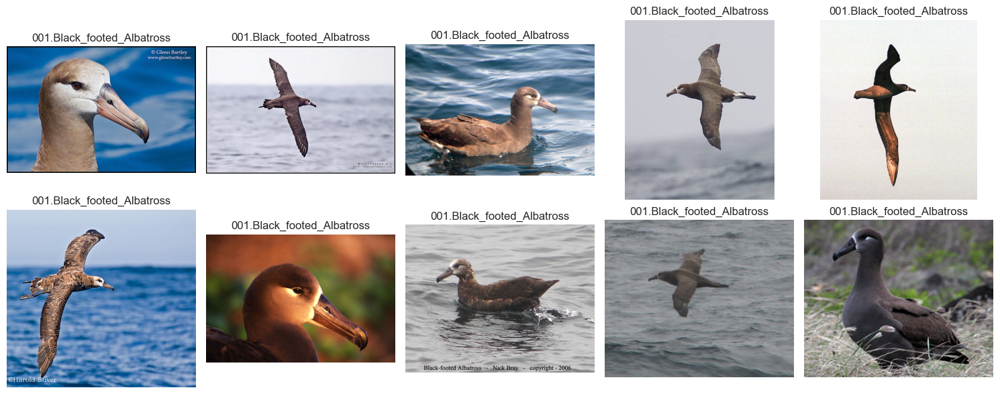

In [122]:
display_sample_images_horizontally(bird_2019 , 'image_dir' , 10 , 'class_name')

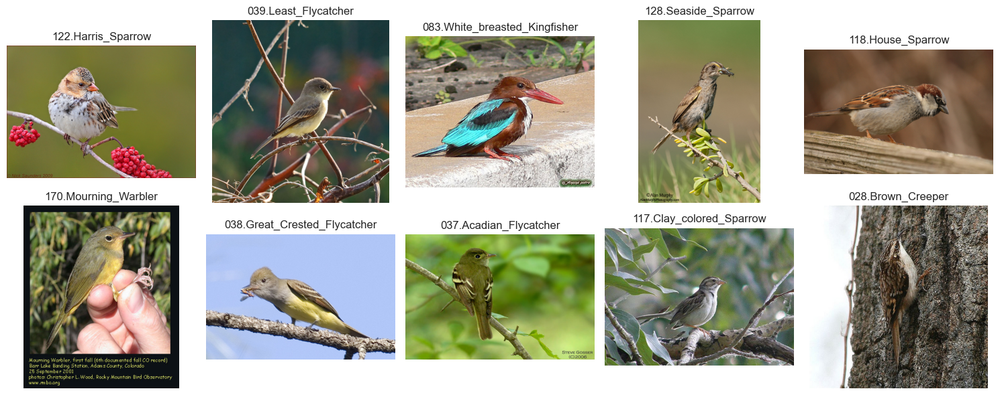

In [123]:
display_sample_images_randomly(bird_2019 , 'image_dir' , 10 , 'class_name')

# Plot the Frequency for each class in class_name

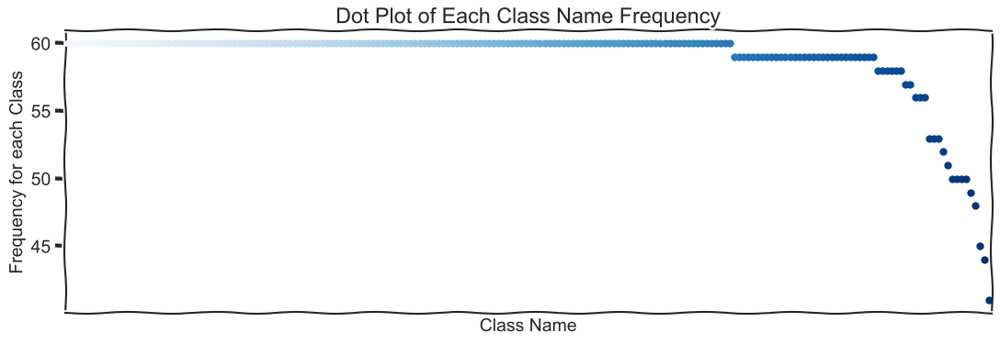

In [125]:
sns.set_style("ticks")

class_counts = bird_2019['class_name'].value_counts().reset_index()
class_counts.columns = ['class_name', 'frequency']
plt.figure(figsize=(13, 4))  
sns.stripplot(x='class_name', y='frequency', data=class_counts, hue='class_name', palette='Blues' , jitter=True, size=6)
plt.xlabel('Class Name')
plt.ylabel('Frequency for each Class')
plt.title('Dot Plot of Each Class Name Frequency')

# Hide X-axis 
plt.xticks([])
plt.xkcd()

plt.show()

In [143]:
imblanced_classes = class_counts[class_counts['frequency'] < 55]

In [144]:
imblanced_classes

,class_name,frequency
186,084.Red_legged_Kittiwake,53
187,032.Mangrove_Cuckoo,53
188,007.Parakeet_Auklet,53
189,024.Red_faced_Cormorant,52
190,151.Black_capped_Vireo,51
191,101.White_Pelican,50
192,187.American_Three_toed_Woodpecker,50
193,113.Baird_Sparrow,50
194,065.Slaty_backed_Gull,50
195,105.Whip_poor_Will,49


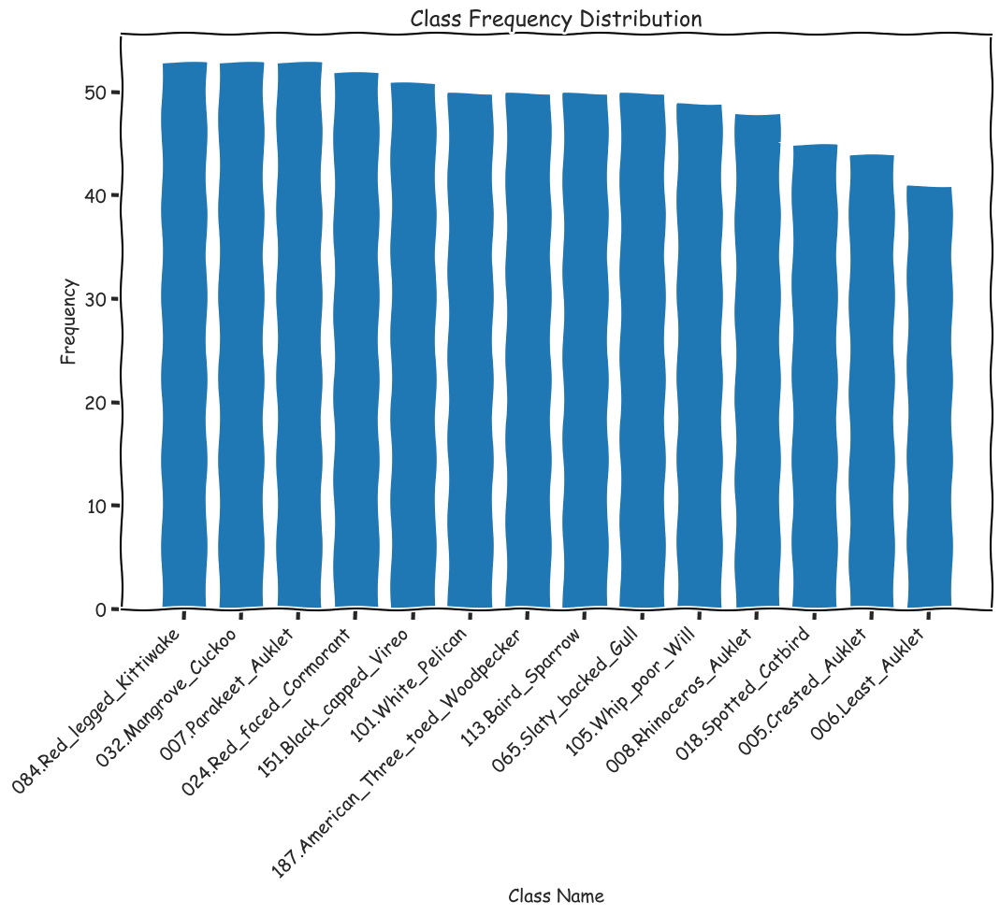

In [147]:
plt.figure(figsize=(12, 8))
plt.bar(imblanced_classes['class_name'], imblanced_classes['frequency'])
plt.xlabel('Class Name')
plt.ylabel('Frequency')
plt.title('Class Frequency Distribution')
plt.xticks(ticks=range(len(imblanced_classes['class_name'])), labels=imblanced_classes['class_name'], rotation=45, ha='right')
plt.show()

# Split the data 

In [34]:
bird_2019  = pd.read_csv('data/bird_2019.csv')

In [422]:
bird_2019.head()

,image_id,image_dir,class_id,class_name,back,barest,beak,belly,crown,forehead,...,has_wing_pattern::multi-colored,has_wing_pattern::solid,has_wing_pattern::spotted,has_wing_pattern::striped,has_wing_shape::broad-wings,has_wing_shape::long-wings,has_wing_shape::pointed-wings,has_wing_shape::rounded-wings,has_wing_shape::tapered-wings,Bounding box
0,1,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 312.0, 'Y_part': 182.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 186.0, 'Y_part': 45.0, 'visible': 1}","{'X_part': 247.0, 'Y_part': 79.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'X_bound_box': 60.0, 'Y_bound_box': 27.0, 'wi..."
1,2,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 228.0, 'Y_part': 138.0, 'visible': 1}","{'X_part': 248.0, 'Y_part': 158.0, 'visible': 1}","{'X_part': 282.0, 'Y_part': 154.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 266.0, 'Y_part': 141.0, 'visible': 1}","{'X_part': 272.0, 'Y_part': 144.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'not visible'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'X_bound_box': 139.0, 'Y_bound_box': 30.0, 'w..."
2,3,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 227.0, 'Y_part': 213.0, 'visible': 1}","{'X_part': 325.0, 'Y_part': 243.0, 'visible': 1}","{'X_part': 376.0, 'Y_part': 160.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 324.0, 'Y_part': 121.0, 'visible': 1}","{'X_part': 349.0, 'Y_part': 128.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'probably'}","{'is_present': '1', 'certainty': 'probably'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'X_bound_box': 14.0, 'Y_bound_box': 112.0, 'w..."
3,4,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 221.0, 'Y_part': 179.0, 'visible': 1}","{'X_part': 190.0, 'Y_part': 215.0, 'visible': 1}","{'X_part': 126.0, 'Y_part': 203.0, 'visible': 1}","{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}","{'X_part': 157.0, 'Y_part': 180.0, 'visible': 1}","{'X_part': 145.0, 'Y_part': 187.0, 'visible': 1}",...,"{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '1', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'is_present': '0', 'certainty': 'definitely'}","{'X_bound_box': 112.0, 'Y_bound_box': 90.0, 'w..."
4,5,001.Black_footed_Albatross/Black_Footed_Albatr...,1,001.Black_footed_Albatross,"{'X_part': 0.0, 'Y_part': 0.0, 'visible': 0}"

In [175]:
train_paths, test_paths = train_test_split(bird_2019['image_dir'], test_size=0.3 , random_state=42)

In [114]:
testing_folder = r'data\testing_images'
os.makedirs(testing_folder, exist_ok=True)

# Move the test training training_images to 'data/testing_images' and remove them from the training training_images folder


In [50]:
for path in test_paths:
    if os.path.exists(path):
        filename = os.path.basename(path) #get the image name 
        print(filename)
        new_path = os.path.join(testing_folder, filename)
        print(new_path)
        shutil.move(path, new_path)
    else:
        print(f"File not found: {path}")


Cliff_Swallow_0092_132971.jpg
data\testing_images\Cliff_Swallow_0092_132971.jpg
Louisiana_Waterthrush_0045_795274.jpg
data\testing_images\Louisiana_Waterthrush_0045_795274.jpg
European_Goldfinch_0045_794690.jpg
data\testing_images\European_Goldfinch_0045_794690.jpg
Purple_Finch_0096_27688.jpg
data\testing_images\Purple_Finch_0096_27688.jpg
Downy_Woodpecker_0030_184368.jpg
data\testing_images\Downy_Woodpecker_0030_184368.jpg
Pied_Billed_Grebe_0091_35276.jpg
data\testing_images\Pied_Billed_Grebe_0091_35276.jpg
Elegant_Tern_0045_150752.jpg
data\testing_images\Elegant_Tern_0045_150752.jpg
Hooded_Merganser_0049_79136.jpg
data\testing_images\Hooded_Merganser_0049_79136.jpg
Boat_Tailed_Grackle_0067_34032.jpg
data\testing_images\Boat_Tailed_Grackle_0067_34032.jpg
Black_Billed_Cuckoo_0006_26233.jpg
data\testing_images\Black_Billed_Cuckoo_0006_26233.jpg
Gray_Catbird_0069_21065.jpg
data\testing_images\Gray_Catbird_0069_21065.jpg
Rose_Breasted_Grosbeak_0117_39601.jpg
data\testing_images\Rose_Breas

# Update the pathes in data set 

In [176]:
def update_path(new_base , path):
    last_segment = path.split('/')[-1]
    return new_base + last_segment

In [177]:
new_base = 'data/testing_images/'

In [178]:
bird_2019['image_dir'] = bird_2019['image_dir'].apply(lambda path: update_path(new_base, path) if path in test_paths.values else path )

In [179]:
bird_2019['image_dir'].head(50) 

0     data/testing_images/Black_Footed_Albatross_004...
1     data/images/001.Black_footed_Albatross/Black_F...
2     data/images/001.Black_footed_Albatross/Black_F...
3     data/testing_images/Black_Footed_Albatross_007...
4     data/images/001.Black_footed_Albatross/Black_F...
5     data/images/001.Black_footed_Albatross/Black_F...
6     data/images/001.Black_footed_Albatross/Black_F...
7     data/images/001.Black_footed_Albatross/Black_F...
8     data/testing_images/Black_Footed_Albatross_001...
9     data/images/001.Black_footed_Albatross/Black_F...
10    data/testing_images/Black_Footed_Albatross_002...
11    data/images/001.Black_footed_Albatross/Black_F...
12    data/images/001.Black_footed_Albatross/Black_F...
13    data/images/001.Black_footed_Albatross/Black_F...
14    data/testing_images/Black_Footed_Albatross_004...
15    data/images/001.Black_footed_Albatross/Black_F...
16    data/images/001.Black_footed_Albatross/Black_F...
17    data/images/001.Black_footed_Albatross/Bla

In [180]:
bird_2019['image_dir'] = bird_2019['image_dir'].apply(lambda dir : dir.replace('data/images/' , 'data/training_images/'))

In [181]:
bird_2019['image_dir'][0:3]

0    data/testing_images/Black_Footed_Albatross_004...
1    data/training_images/001.Black_footed_Albatros...
2    data/training_images/001.Black_footed_Albatros...
Name: image_dir, dtype: object

In [59]:
plt.rcParams.update(plt.rcParamsDefault)  # Reset to default parameters

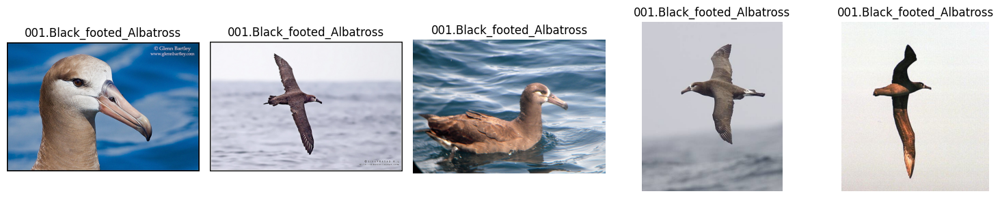

In [60]:
display_sample_images_horizontally(bird_2019, 'image_dir' , 5  , 'class_name')

In [182]:
bird_2019['is_training'] = bird_2019['image_dir'].apply(lambda dir: 0 if 'testing' in dir else 1)

In [183]:
bird_2019.head()

,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,beak_Y_part,beak_visible,...,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,X_bound_box,Y_bound_box,width_bound_box,height_bound_box,is_training
0,1,data/testing_images/Black_Footed_Albatross_004...,1,001.Black_footed_Albatross,0.0,0.0,0.0,312.0,182.0,1.0,...,not visible,0,not visible,0,not visible,60.0,27.0,325.0,304.0,0
1,2,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,154.0,1.0,...,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0,1
2,3,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,160.0,1.0,...,probably,1,probably,0,probably,14.0,112.0,388.0,186.0,1
3,4,data/testing_images/Black_Footed_Albatross_007...,1,001.Black_footed_Albatross,221.0,179.0,1.0,126.0,203.0,1.0,...,definitely,0,definitely,0,definitely,112.0,90.0,255.0,242.0,0
4,5,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,147.0,1.0,...,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0,1


In [184]:
bird_2019[['image_dir' , 'is_training']]

,image_dir,is_training
0,data/testing_images/Black_Footed_Albatross_004...,0
1,data/training_images/001.Black_footed_Albatros...,1
2,data/training_images/001.Black_footed_Albatros...,1
3,data/testing_images/Black_Footed_Albatross_007...,0
4,data/training_images/001.Black_footed_Albatros...,1
...,...,...
11783,data/training_images/200.Common_Yellowthroat/C...,1
11784,data/training_images/200.Common_Yellowthroat/C...,1
11785,data/training_images/200.Common_Yellowthroat/C...,1
11786,data/testing_images/Common_Yellowthroat_0049_1...,0


In [185]:
# Move 'is_training' to be before 'image_dir'
cols = ['is_training'] + [col for col in bird_2019.columns if col != 'is_training']

In [186]:
cols

['is_training',
 'image_id',
 'image_dir',
 'class_id',
 'class_name',
 'back_X_part',
 'back_Y_part',
 'back_visible',
 'beak_X_part',
 'beak_Y_part',
 'beak_visible',
 'belly_X_part',
 'belly_Y_part',
 'belly_visible',
 'barest_X_part',
 'barest_Y_part',
 'barest_visible',
 'crown_X_part',
 'crown_Y_part',
 'crown_visible',
 'forehead_X_part',
 'forehead_Y_part',
 'forehead_visible',
 'left eye_X_part',
 'left eye_Y_part',
 'left eye_visible',
 'left leg_X_part',
 'left leg_Y_part',
 'left leg_visible',
 'left wing_X_part',
 'left wing_Y_part',
 'left wing_visible',
 'nape_X_part',
 'nape_Y_part',
 'nape_visible',
 'right eye_X_part',
 'right eye_Y_part',
 'right eye_visible',
 'right leg_X_part',
 'right leg_Y_part',
 'right leg_visible',
 'right wing_X_part',
 'right wing_Y_part',
 'right wing_visible',
 'tail_X_part',
 'tail_Y_part',
 'tail_visible',
 'throat_X_part',
 'throat_Y_part',
 'throat_visible',
 'has_bill_shape::curved_(up_or_down)_is_present',
 'has_bill_shape::curved_(

In [187]:
bird_2019 = bird_2019[cols]

In [188]:
bird_2019.head()

,is_training,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,beak_Y_part,...,has_wing_pattern::spotted_is_present,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
0,0,1,data/testing_images/Black_Footed_Albatross_004...,1,001.Black_footed_Albatross,0.0,0.0,0.0,312.0,182.0,...,0,not visible,0,not visible,0,not visible,60.0,27.0,325.0,304.0
1,1,2,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,154.0,...,0,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0
2,1,3,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,160.0,...,0,probably,1,probably,0,probably,14.0,112.0,388.0,186.0
3,0,4,data/testing_images/Black_Footed_Albatross_007...,1,001.Black_footed_Albatross,221.0,179.0,1.0,126.0,203.0,...,0,definitely,0,definitely,0,definitely,112.0,90.0,255.0,242.0
4,1,5,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,147.0,...,0,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0


In [189]:
bird_2019.to_csv('C:/Users/IMOE001/PycharmProjects/BridProject3/data/updated_bird_2019.csv', index=False)

In [3]:
updated_bird_2019  = pd.read_csv('data/updated_bird_2019.csv')

In [4]:
updated_bird_2019.head()

,is_training,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,beak_Y_part,...,has_wing_pattern::spotted_is_present,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
0,0,1,data/testing_images/Black_Footed_Albatross_004...,1,001.Black_footed_Albatross,0.0,0.0,0.0,312.0,182.0,...,0,not visible,0,not visible,0,not visible,60.0,27.0,325.0,304.0
1,1,2,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,154.0,...,0,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0
2,1,3,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,160.0,...,0,probably,1,probably,0,probably,14.0,112.0,388.0,186.0
3,0,4,data/testing_images/Black_Footed_Albatross_007...,1,001.Black_footed_Albatross,221.0,179.0,1.0,126.0,203.0,...,0,definitely,0,definitely,0,definitely,112.0,90.0,255.0,242.0
4,1,5,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,147.0,...,0,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0


# Data Augmentation

In [5]:
training_bird_2019 = updated_bird_2019[updated_bird_2019['is_training'] == 1]
testing_bird_2019 = updated_bird_2019[updated_bird_2019['is_training'] == 0]

In [6]:
training_bird_2019.reset_index(inplace=True)

In [8]:
training_bird_2019

,index,is_training,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,...,has_wing_pattern::spotted_is_present,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
0,1,1,2,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,...,0,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0
1,2,1,3,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,...,0,probably,1,probably,0,probably,14.0,112.0,388.0,186.0
2,4,1,5,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,...,0,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0
3,5,1,6,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,163.0,180.0,1.0,264.0,...,1,definitely,0,definitely,0,definitely,33.0,53.0,251.0,395.0
4,6,1,7,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,0.0,0.0,0.0,362.0,...,0,not visible,0,not visible,0,not visible,7.0,75.0,420.0,262.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8246,11781,1,11782,data/training_images/200.Common_Yellowthroat/C...,200,200.Common_Yellowthroat,0.0,0.0,0.0,272.0,...,0,not visible,0,not visible,0,not visible,140.0,125.0,144.0,172.0
8247,11782,1,11783,data/training_images/200.Common_Yellowthroat/C...,200,200.Common_Yellowthroat,233.0,119.0,1.0,327.0,...,0,definitely,0,definitely,1,definitely,96.0,71.0,243.0,216.0
8248,11783,1,11784,data/training_images/200.Common_Yellowthroat/C...,200,200.Common_Yellowthroat,235.0,155.0,1.0,106.0,...,0,probably,0,probably,0,probably,89.0,95.0,354.0,250.0
8249,11784,1,11785,data/training_images/200.Common_Yellowthroat/C...,200,200.Common_Yellowthroat,275.0,109.0,1.0,170.0,...,0,not visible,0,not visible,0,not visible,157.0,62.0,184.0,219.0


# Horizontal Flip.

In [256]:
def save_image(img, img_dir, sub_dir):
    """
    Save an image to a different directory with a sub-directory.

    img: The image to be saved (PIL Image object).
    img_dir: The original directory of the image.
    sub_dir: Sub-directory to be added after 'augmented_images/'.

    Returns:
        string: The new directory for the image.
    """

    the_base = img_dir.split('/')[-1]

    new_image_dir = f'augmented_images/{sub_dir}/' + str(the_base)

    os.makedirs(os.path.dirname(new_image_dir), exist_ok=True)

    img.save(new_image_dir)

    return new_image_dir

In [257]:
def horizontal_flip(row):
    """
    Flip an image horizontally , and Modify it's bounding Box .

    row (pd.Series): A row from a DataFrame containing 'image_dir' and 'Bounding box'.

    Returns:
        tuple: (flipped_image, bounding box)
    """
    image = Image.open(row['image_dir'])
    width = image.width
    flipped_image = image.transpose(Image.FLIP_LEFT_RIGHT)
    
    new_x_bound = width - row['X_bound_box'] - row['width_bound_box']
    new_image_dir = save_image(flipped_image , row['image_dir'] ,'horizontal_fliped_images' )

    return new_image_dir, new_x_bound , row['Y_bound_box'] , row['width_bound_box'] , row['height_bound_box']

In [258]:
test = training_bird_2019.copy()

In [259]:
test.head()

,index,is_training,image_id,image_dir,class_id,class_name,back_X_part,back_Y_part,back_visible,beak_X_part,...,has_wing_pattern::spotted_is_present,has_wing_pattern::spotted_certainty,has_wing_pattern::striped_is_present,has_wing_pattern::striped_certainty,has_wing_pattern::multi-colored_is_present,has_wing_pattern::multi-colored_certainty,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
0,1,1,2,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,228.0,138.0,1.0,282.0,...,0,not visible,0,not visible,0,not visible,139.0,30.0,153.0,264.0
1,2,1,3,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,227.0,213.0,1.0,376.0,...,0,probably,1,probably,0,probably,14.0,112.0,388.0,186.0
2,4,1,5,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,0.0,0.0,0.0,194.0,...,0,not visible,0,not visible,0,not visible,70.0,50.0,134.0,303.0
3,5,1,6,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,163.0,180.0,1.0,264.0,...,1,definitely,0,definitely,0,definitely,33.0,53.0,251.0,395.0
4,6,1,7,data/training_images/001.Black_footed_Albatros...,1,001.Black_footed_Albatross,0.0,0.0,0.0,362.0,...,0,not visible,0,not visible,0,not visible,7.0,75.0,420.0,262.0


In [260]:
result = test[1:4].apply(lambda row: pd.Series(horizontal_flip(row)), axis=1)

In [261]:
result.columns = ['image_dir' , 'X_bound_box' , 'Y_bound_box' , 'width_bound_box' , 'height_bound_box']

In [262]:
result

,image_dir,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
1,augmented_images/horizontal_fliped_images/Blac...,98.0,112.0,388.0,186.0
2,augmented_images/horizontal_fliped_images/Blac...,127.0,50.0,134.0,303.0
3,augmented_images/horizontal_fliped_images/Blac...,216.0,53.0,251.0,395.0


In [180]:
def display_image_with_bbox(row):
    """
    Display an image with its given bounding box.

    Parameters:
    row (pd.Series): A row from a DataFrame containing 'image_dir' and Bounding box coordinates .
    """
    plt.rcParams.update(plt.rcParamsDefault)

    image = Image.open(row['image_dir'])
    fig, ax = plt.subplots(1, 1, figsize=(10, 5))

    ax.imshow(image)
    rect = patches.Rectangle(
        (row['X_bound_box'], row['Y_bound_box']),
        row['width_bound_box'],
        row['height_bound_box'],
        linewidth=2,
        edgecolor='r',
        facecolor='none'
    )
    ax.add_patch(rect)
    ax.set_title(f'Image with Bounding Box')
    ax.axis('off')
    plt.show()

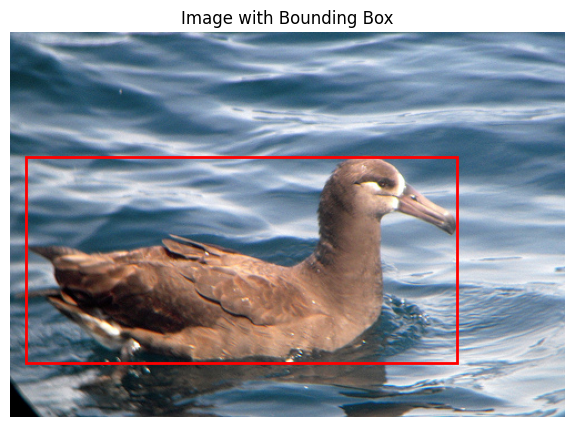

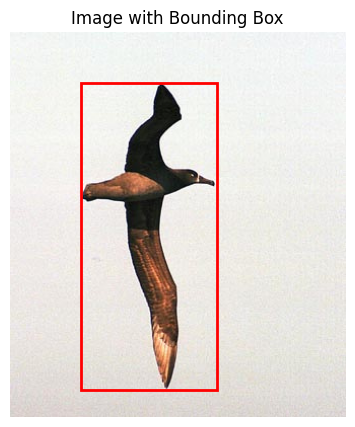

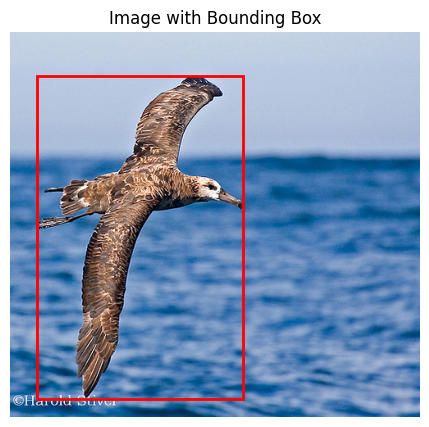

In [181]:
for idx, row in test[1:4].iterrows():
    display_image_with_bbox(row)

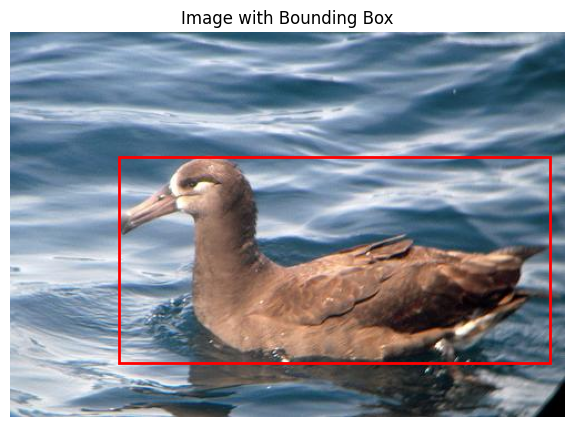

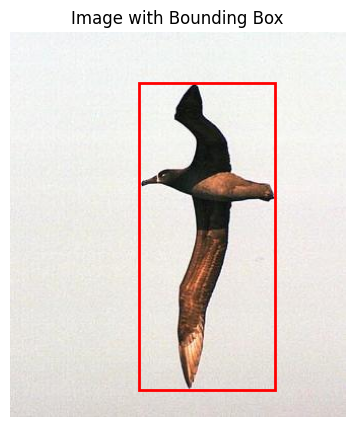

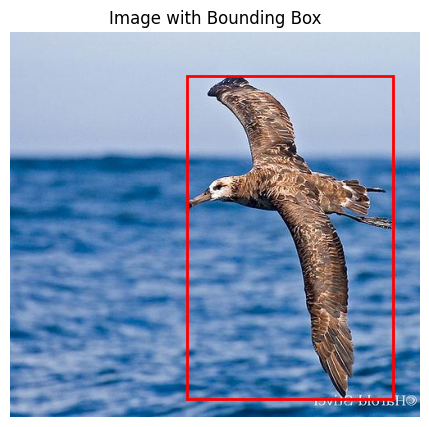

In [182]:
for idx, row in result.iterrows():
    display_image_with_bbox(row)

In [16]:
def display_image_with_bbox_in_axis(row, ax):
    """
    Display an image with its given bounding box on the provided axes.

    Parameters:
    row (pd.Series): A row from a DataFrame containing 'image_dir' and 'Bounding box'.
    ax (matplotlib.axes._axes.Axes): The axes on which to display the image.
    """
    image = Image.open(row['image_dir'])
    ax.imshow(image)
    rect = patches.Rectangle(
        (row['X_bound_box'], row['Y_bound_box']),
        row['width_bound_box'],
        row['height_bound_box'],
        linewidth=2,
        edgecolor='r',
        facecolor='none'
    )
    ax.add_patch(rect)
    ax.set_title(f'Image {row.name + 1}')
    ax.axis('off')

In [17]:
def augment_and_display_data(row, augmentation_func):
    """
    Apply augmentation to the image and display the original and augmented images side by side.

    Parameters:
    row (pd.Series): A row from a DataFrame containing 'image_dir' and 'Bounding box' coordinates .
    augmentation_func (function): Function that applies augmentation and returns the augmented image path and bounding box.
    """
    augmented_image_path, x , y , width , hight  = augmentation_func(row)

    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    display_image_with_bbox_in_axis(row, axes[0])
    axes[0].set_title("Original Image" , fontsize=20)

    augmented_row = row.copy()
    augmented_row['image_dir'] = augmented_image_path
    augmented_row['X_bound_box'] = x
    augmented_row['Y_bound_box'] = y
    augmented_row['width_bound_box'] = width
    augmented_row['height_bound_box'] = hight


    display_image_with_bbox_in_axis(augmented_row, axes[1])
    axes[1].set_title(augmentation_func.__name__ , fontsize=20)

    plt.tight_layout()
    plt.show()

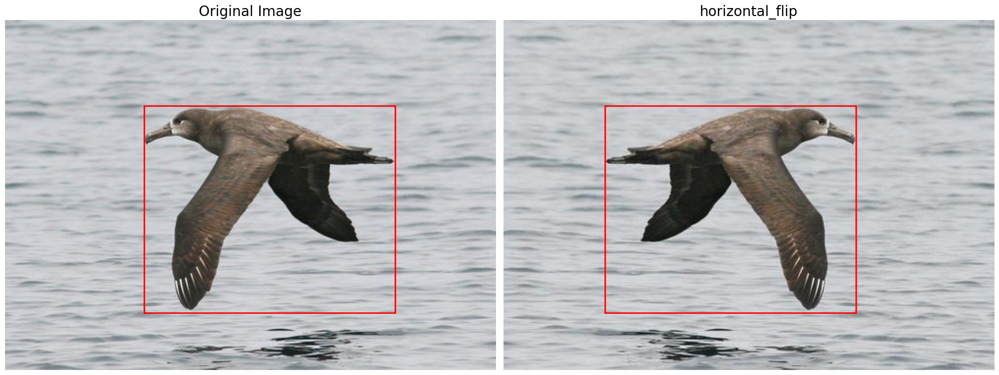

In [18]:
augment_and_display_data(test.iloc[10],horizontal_flip)

# Vertical Flip

In [263]:
def vertical_flip(row):
    """
    Flip an image vertically , and Modify it's bounding Box .

    row (pd.Series): A row from a DataFrame containing 'image_dir' and 'Bounding box'.

    Returns:
        tuple: (flipped_image, bounding box)
    """

    image = Image.open(row['image_dir'])
    height = image.height
    flipped_image = image.transpose(Image.FLIP_TOP_BOTTOM)

    new_y_bound = height - row['Y_bound_box'] - row['height_bound_box']

    new_image_dir = save_image(flipped_image , row['image_dir'] ,'Vertical_fliped_images' )

    return new_image_dir, row['X_bound_box'] , new_y_bound , row['width_bound_box'] , row['height_bound_box']

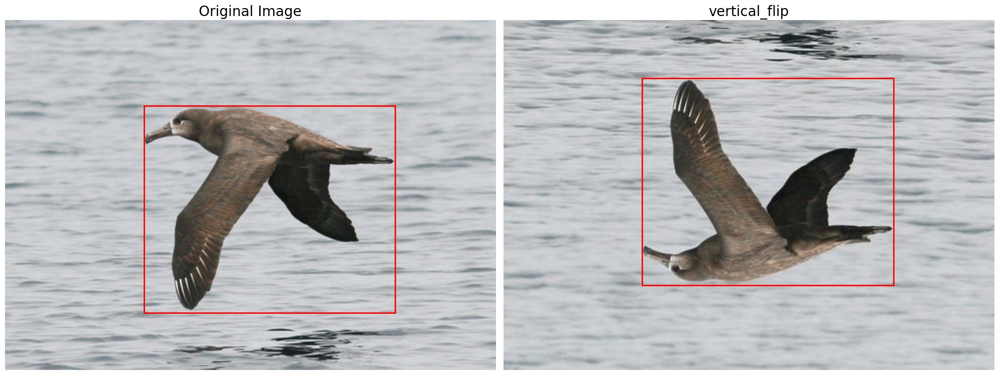

In [264]:
augment_and_display_data(test.iloc[10],vertical_flip)

In [265]:
def zoom_in_image(row, zoom_factor = 1.5):

    image = Image.open(row['image_dir'])
    image = np.array(image)

    height, width = image.shape[:2]

    crop_percentage = 1 / zoom_factor
    start_x = int(width * (1 - crop_percentage) / 2)
    end_x = int(width * (1 + crop_percentage) / 2)
    start_y = int(height * (1 - crop_percentage) / 2)
    end_y = int(height * (1 + crop_percentage) / 2)

    cropped_image = image[start_y:end_y, start_x:end_x]

    adjusted_x = row['X_bound_box'] - start_x
    adjusted_y = row['Y_bound_box'] - start_y
    adjusted_w = row['width_bound_box']
    adjusted_h = row['height_bound_box']

    # Ensure the bounding box remains visible within the cropped image
    if adjusted_x < 0:
        adjusted_w += adjusted_x
        adjusted_x = 0
    if adjusted_y < 0:
        adjusted_h += adjusted_y
        adjusted_y = 0
    if adjusted_x + adjusted_w > cropped_image.shape[1]:
        adjusted_w = cropped_image.shape[1] - adjusted_x
    if adjusted_y + adjusted_h > cropped_image.shape[0]:
        adjusted_h = cropped_image.shape[0] - adjusted_y


    new_image_dir = save_image(Image.fromarray(cropped_image) , row['image_dir'] , 'zoomed_images')

    return  new_image_dir , adjusted_x  , adjusted_y , adjusted_w , adjusted_h

In [266]:
 result = test[5:15].apply(lambda row: pd.Series(zoom_in_image(row , 1.5 )), axis=1)

In [267]:
result.columns =  ['image_dir' , 'X_bound_box' , 'Y_bound_box' , 'width_bound_box' , 'height_bound_box']

In [268]:
result

,image_dir,X_bound_box,Y_bound_box,width_bound_box,height_bound_box
5,augmented_images/zoomed_images/Black_Footed_Al...,0.0,21.0,328.0,158.0
6,augmented_images/zoomed_images/Black_Footed_Al...,0.0,0.0,167.0,139.0
7,augmented_images/zoomed_images/Black_Footed_Al...,0.0,0.0,156.0,187.0
8,augmented_images/zoomed_images/Black_Footed_Al...,0.0,0.0,182.0,333.0
9,augmented_images/zoomed_images/Black_Footed_Al...,0.0,0.0,233.0,166.0
10,augmented_images/zoomed_images/Black_Footed_Al...,58.0,28.0,256.0,210.0
11,augmented_images/zoomed_images/Black_Footed_Al...,0.0,0.0,233.0,189.0
12,augmented_images/zoomed_images/Black_Footed_Al...,0.0,3.0,216.0,220.0
13,augmented_images/zoomed_images/Black_Footed_Al...,52.0,24.0,281.0,181.0
14,augmented_images/zoomed_images/Black_Footed_Al...,0.0,0.0,143.0,91.0


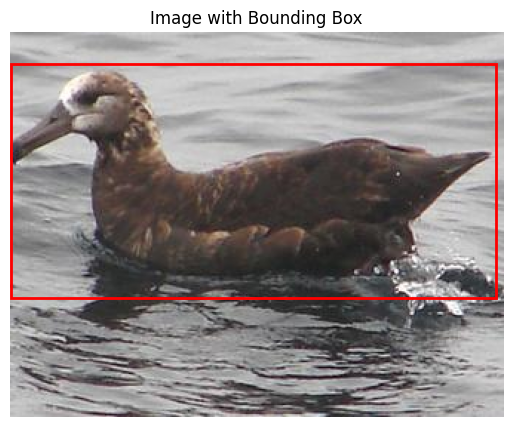

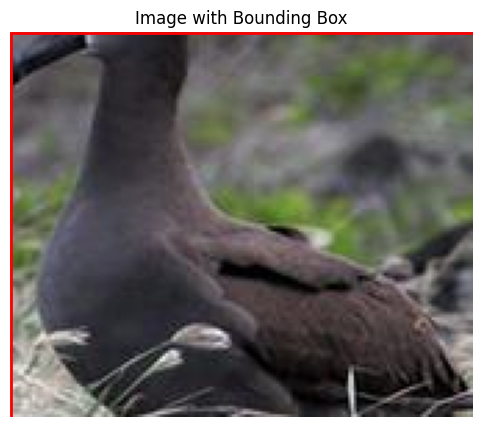

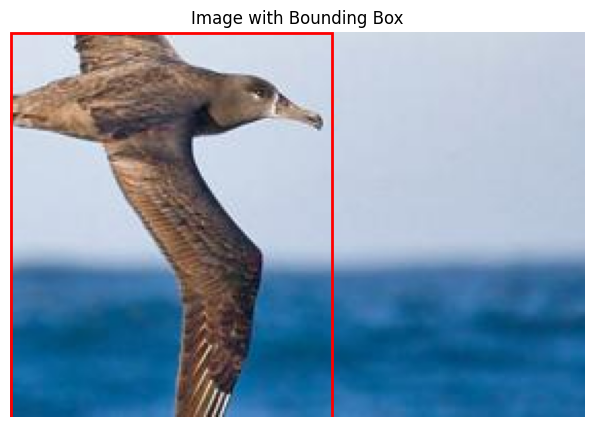

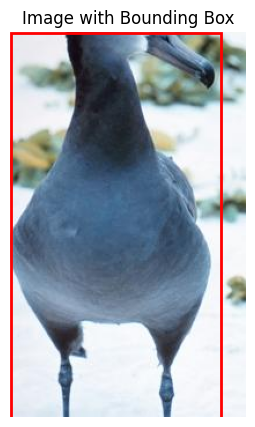

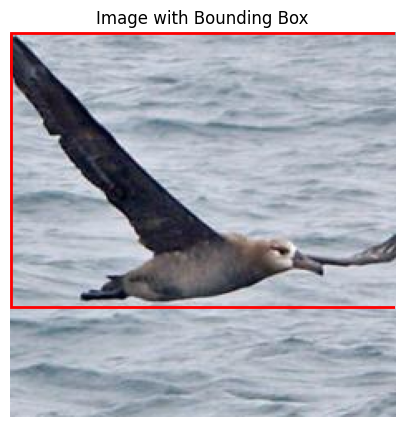

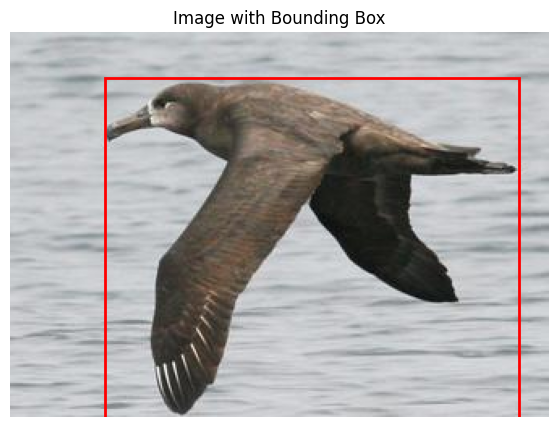

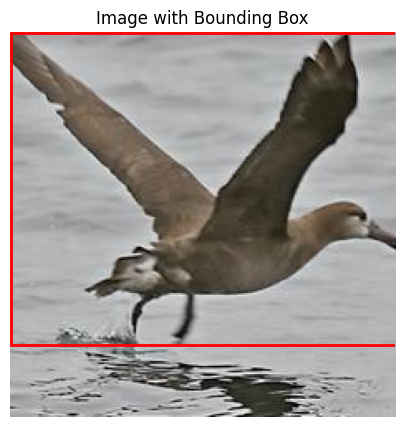

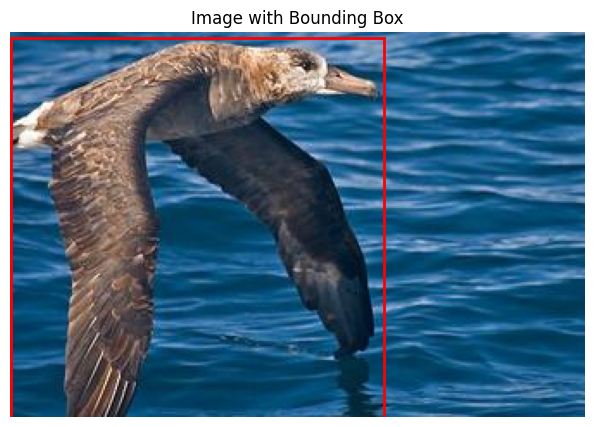

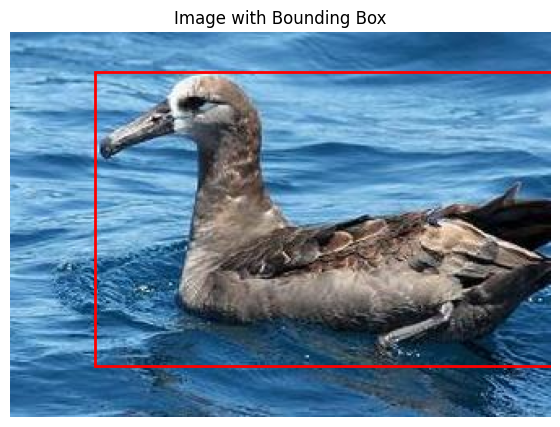

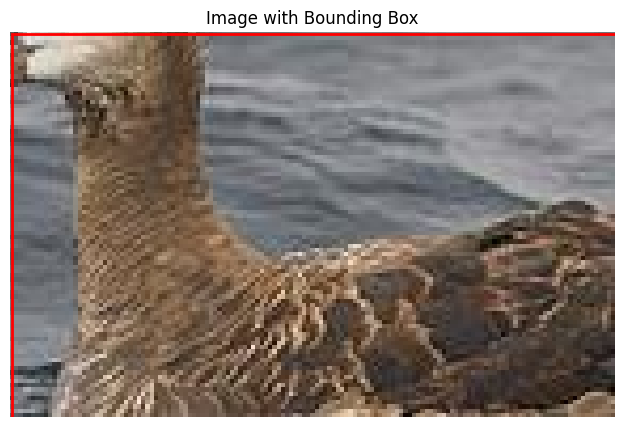

In [269]:
for idx, row in result.iterrows():
    display_image_with_bbox(row)

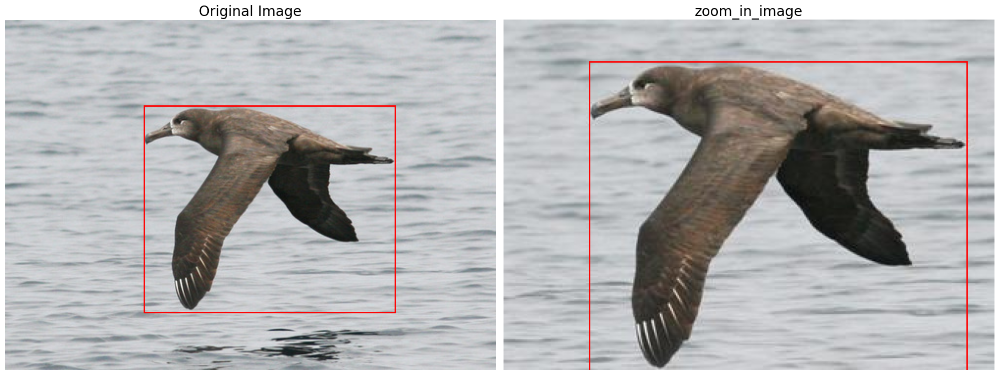

In [270]:
augment_and_display_data(test.iloc[10] , zoom_in_image)

# Image Translating


In [271]:
def translate_image(row):
    """
    Translate the image and bounding box randomly within the image boundaries.

    Parameters:
    - row: A DataFrame row containing image path and bounding box.

    Returns:
       tuple (padded_img_path, bounding box)

    """
    image_path = row['image_dir']
    image = Image.open(image_path)
    img = np.array(image)
    height, width = img.shape[:2]

    max_dx = width - row['width_bound_box']
    max_dy = height - row['height_bound_box']

    # How much the image and bounding box will be shifted
    dx = random.randint(-int(row['X_bound_box']), int(max_dx - row['X_bound_box']))
    dy = random.randint(-int(row['Y_bound_box']), int(max_dy - row['Y_bound_box']))

    # Ensure the new bounding box does not go into the padding space
    adjusted_x = max(0, min(row['X_bound_box'] + dx, width - row['width_bound_box']))
    adjusted_y = max(0, min(row['Y_bound_box'] + dy, height - row['height_bound_box']
))

    translation_matrix = np.float32([[1, 0, adjusted_x - row['X_bound_box'] ], [0, 1, adjusted_y - row['Y_bound_box']]])
    translated_img = cv2.warpAffine(img, translation_matrix, (width, height))

    new_image_dir = save_image(Image.fromarray(translated_img) , row['image_dir'] , 'translated_images')

    return new_image_dir, adjusted_x , adjusted_y , row['width_bound_box'] , row['height_bound_box']

In [272]:
result = test[50:55].apply(lambda row: pd.Series(translate_image(row )), axis=1)

In [273]:
result.columns =  ['image_dir' , 'X_bound_box' , 'Y_bound_box' , 'width_bound_box' , 'height_bound_box']

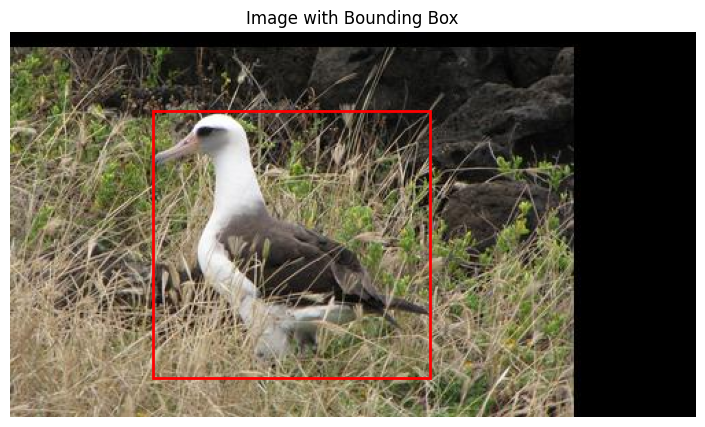

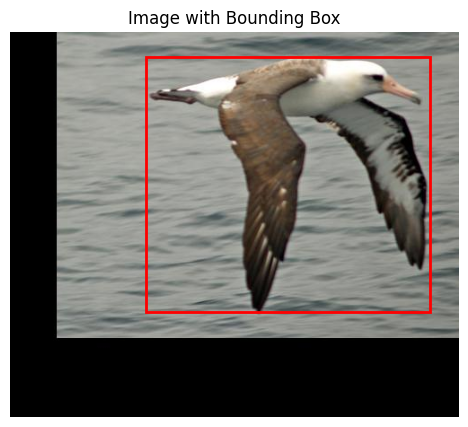

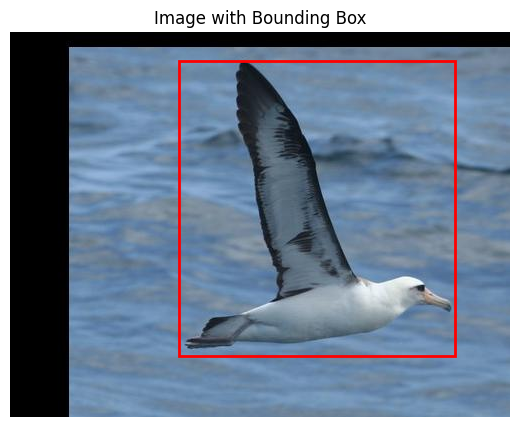

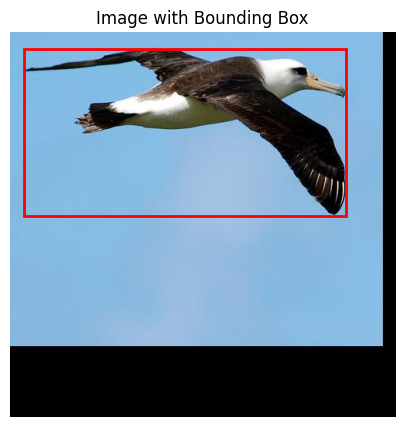

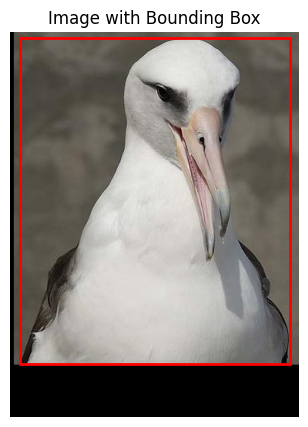

In [274]:
for idx, row in result.iterrows():
    display_image_with_bbox(row)

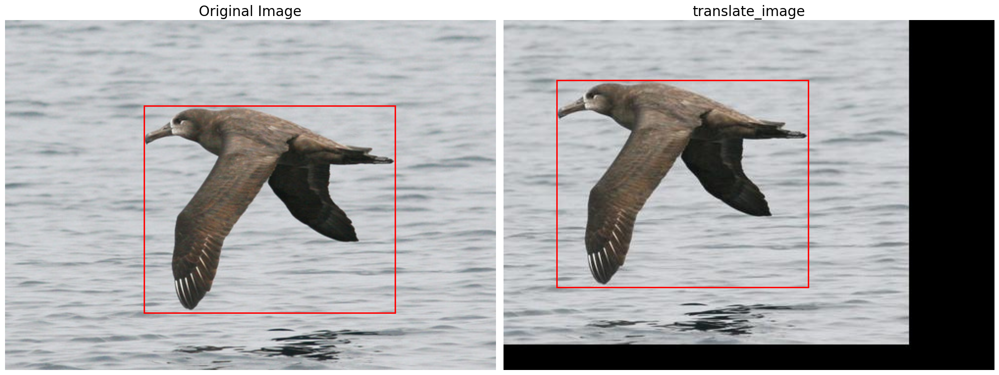

In [275]:
augment_and_display_data(test.iloc[10],translate_image)

# Rotation

In [276]:
def rotate_image(row):
    """
    Rotate the image and bounding box randomly between 0 and 15 degrees.

    Parameters:
    - row: A DataFrame row containing image path and bounding box.

    Returns:
    - new_image_path: Path to the saved rotated image.
    - new_bboxes: New bounding box coordinates (width, height, x, y).
    """
    image_path = row['image_dir']
    image = Image.open(image_path)
    img = np.array(image)

    height, width = img.shape[:2]

    angle = random.uniform(0, 15)

    img_center = (width / 2 , height / 2)

    rotation_matrix = cv2.getRotationMatrix2D(img_center, angle, 1.0)

    #print(rotation_matrix)

    cos_theta = np.abs(rotation_matrix[0, 0])
    sin_theta = np.abs(rotation_matrix[0, 1])

    #print(cos_theta , sin_theta )

    new_width = int((height * sin_theta) + (width * cos_theta))
    new_height = int((height * cos_theta) + (width * sin_theta))

    rotation_matrix[0, 2] += (new_width / 2) - img_center[0]
    rotation_matrix[1, 2] += (new_height / 2) - img_center[1]

    rotated_img = cv2.warpAffine(img, rotation_matrix, (new_width, new_height), borderMode=cv2.BORDER_CONSTANT, borderValue=(0, 0, 0))

    bbox_x = row['X_bound_box']
    bbox_y = row['Y_bound_box']
    bbox_w = row['width_bound_box']
    bbox_h = row['height_bound_box']

    corners = np.array([ # Compute foure corners
        [bbox_x, bbox_y],
        [bbox_x + bbox_w, bbox_y],
        [bbox_x, bbox_y + bbox_h],
        [bbox_x + bbox_w, bbox_y + bbox_h]
    ])

    ones = np.ones(shape=(len(corners), 1)) # Add columns to ensure compatible shapes
    corners_ones = np.hstack([corners, ones])

    transformed_corners = rotation_matrix.dot(corners_ones.T).T

    x_coords = transformed_corners[:, 0]
    y_coords = transformed_corners[:, 1]

    #print(x_coords , y_coords )

    new_bbox_x = min(x_coords)
    new_bbox_y = min(y_coords)
    new_bbox_w = max(x_coords) - new_bbox_x
    new_bbox_h = max(y_coords) - new_bbox_y

    new_image_dir = save_image(Image.fromarray(rotated_img) , row['image_dir'] , 'rotated_images')

    return  new_image_dir , new_bbox_x , new_bbox_y , new_bbox_w , new_bbox_h

In [277]:
result = test[20: 30].apply(lambda row: pd.Series(rotate_image(row)), axis=1)

In [278]:
result.columns =  ['image_dir' , 'X_bound_box' , 'Y_bound_box' , 'width_bound_box' , 'height_bound_box']

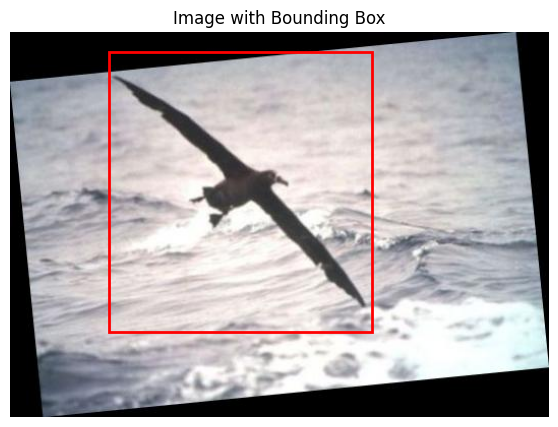

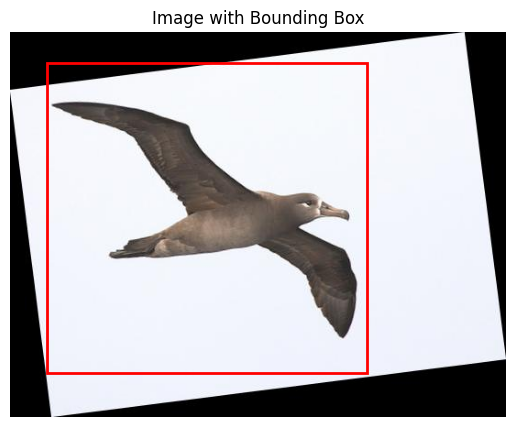

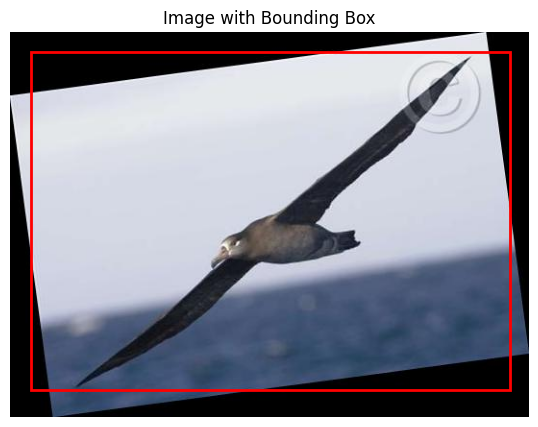

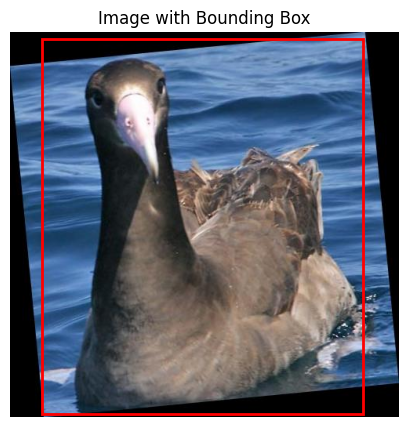

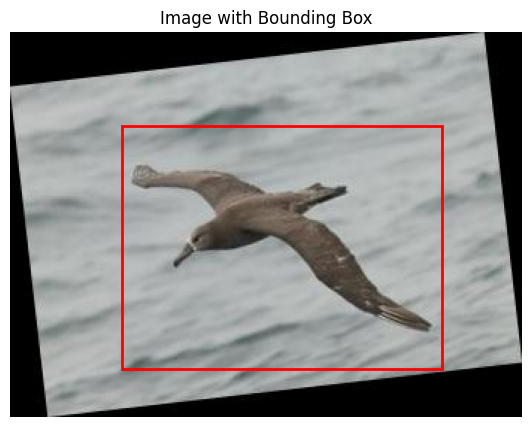

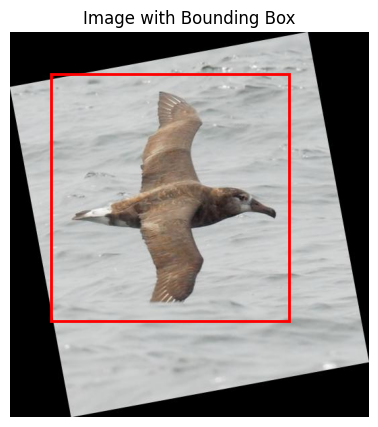

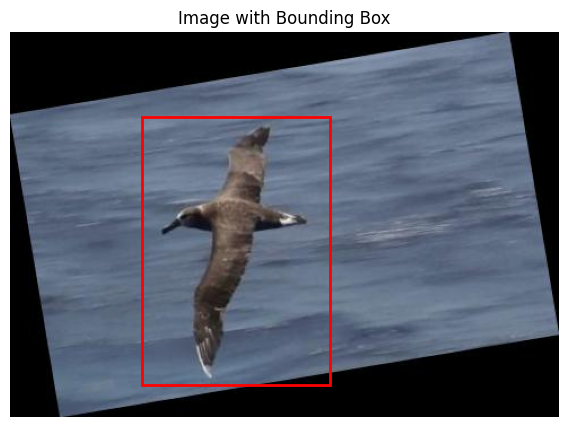

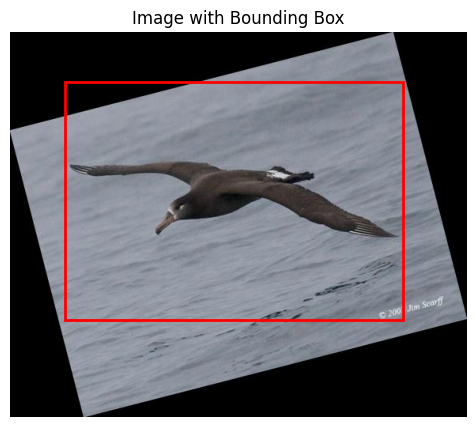

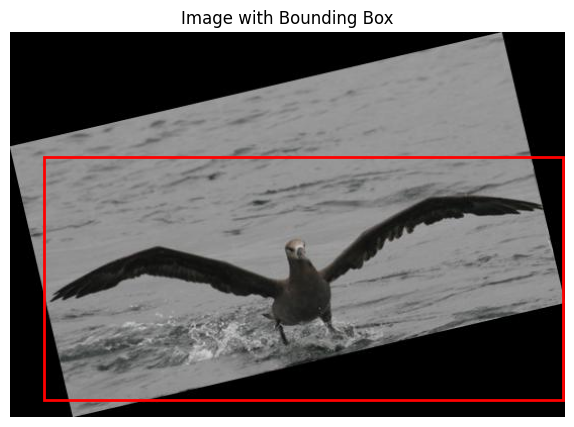

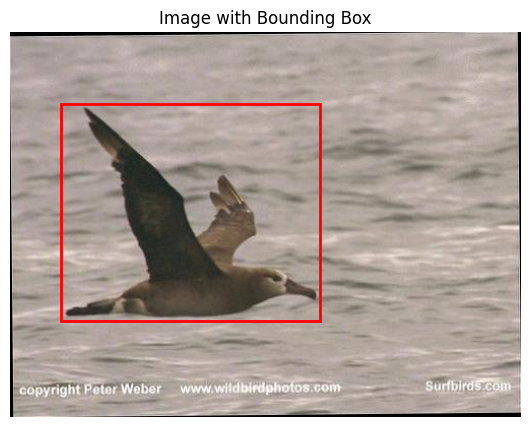

In [279]:
for idx, row in result.iterrows():
    display_image_with_bbox(row)

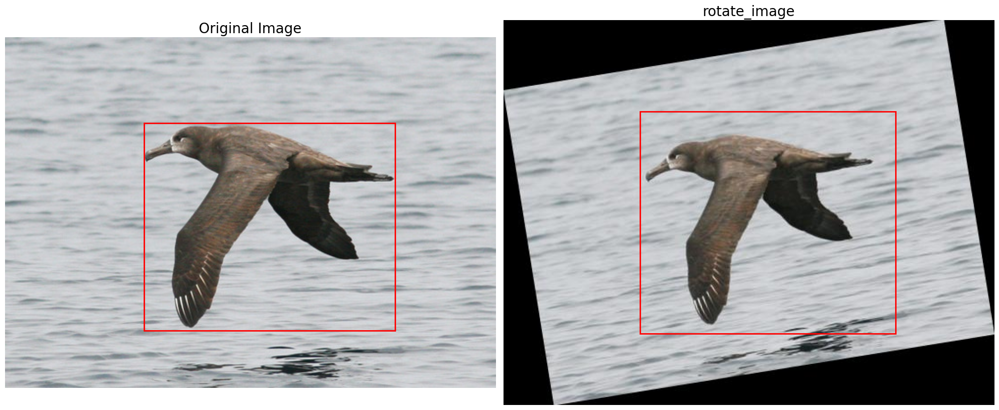

In [162]:
augment_and_display_data(test.iloc[10],rotate_image)

# Filtering

In [280]:
def gaussian_noise(row):
    image = Image.open(row['image_dir'])
    img = np.array(image)

    mean = 0
    stddev = 1.5

    noise = np.random.normal(mean, stddev, img.shape).astype(np.uint8)
    noisy_img = cv2.add(img, noise)

    new_image_dir = save_image(Image.fromarray(noisy_img) , row['image_dir'] , 'noisy_images')

    return new_image_dir ,row['X_bound_box'] , row['Y_bound_box'] , row['width_bound_box'] , row['height_bound_box']

In [281]:
result = test[20:24].apply(lambda row: pd.Series(gaussian_noise(row)), axis=1)

In [282]:
result.columns =  ['image_dir' , 'X_bound_box' , 'Y_bound_box' , 'width_bound_box' , 'height_bound_box']

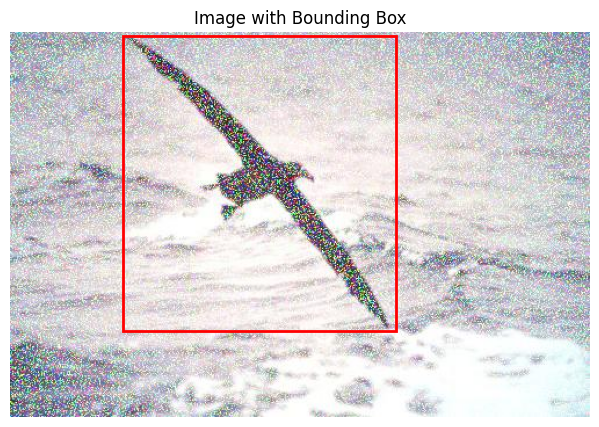

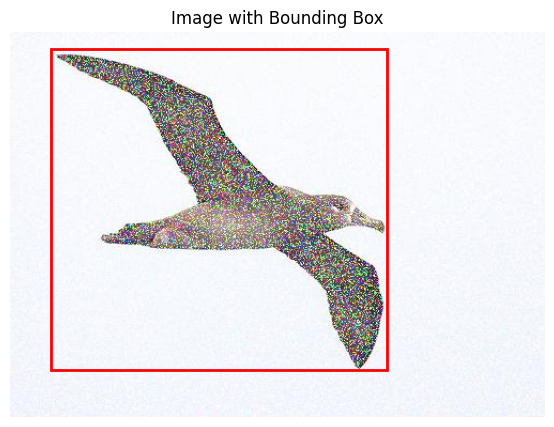

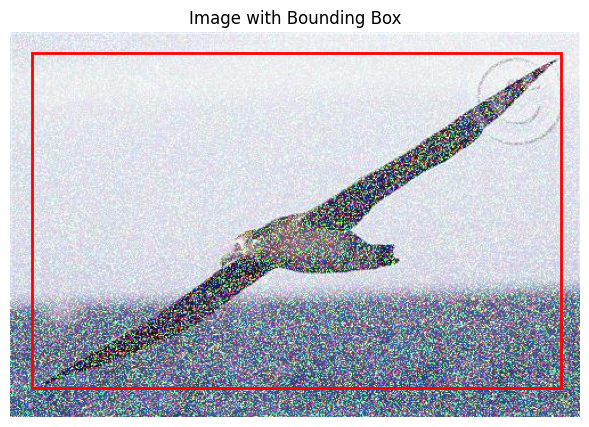

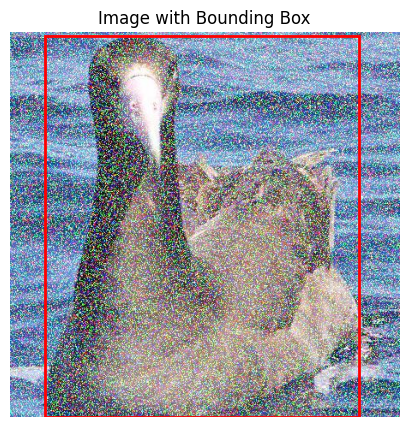

In [283]:
for idx, row in result.iterrows():
    display_image_with_bbox(row)

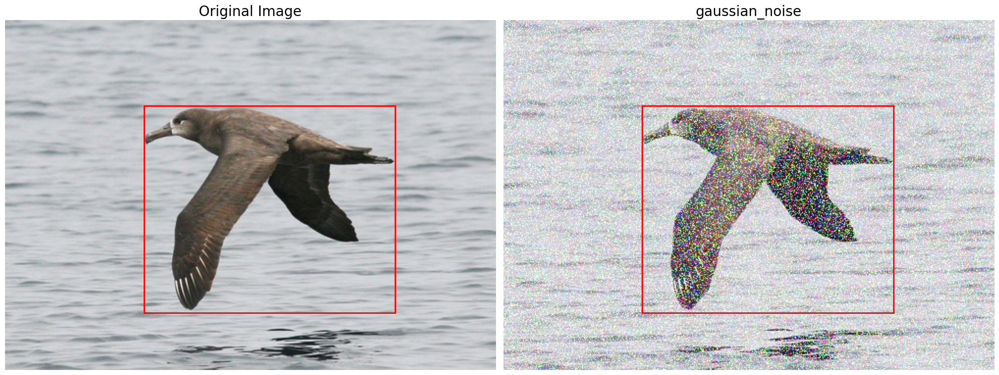

In [284]:
augment_and_display_data(test.iloc[10],gaussian_noise)

In [285]:
 def sharpen_image(row):

    image_path = row['image_dir']
    image = Image.open(image_path)
    img = np.array(image)

    # Define the sharpening kernel
    sharpening_kernel = np.array([
        [0, -1, 0],
        [-1, 5, -1],
        [0, -1, 0]
    ])

    img_float = img.astype(np.float32)
    img_height, img_width = img_float.shape[:2]
    kernel_size = sharpening_kernel.shape[0]
    padding = kernel_size // 2

    padded_img = np.pad(img_float, ((padding, padding), (padding, padding), (0, 0)), mode='constant', constant_values=0)

    sharpened_img = np.zeros_like(img_float)

    for y in range(img_height):
        for x in range(img_width):
            region = padded_img[y:y + kernel_size, x:x + kernel_size]
            sharpened_img[y, x] = np.sum(region * sharpening_kernel[:, :, np.newaxis], axis=(0, 1))

    sharpened_img = np.clip(sharpened_img, 0, 255).astype(np.uint8)

    new_image_dir = save_image(Image.fromarray(sharpened_img) , row['image_dir'] , 'sharpened_images')

    return new_image_dir ,row['X_bound_box'] , row['Y_bound_box'] , row['width_bound_box'] , row['height_bound_box']


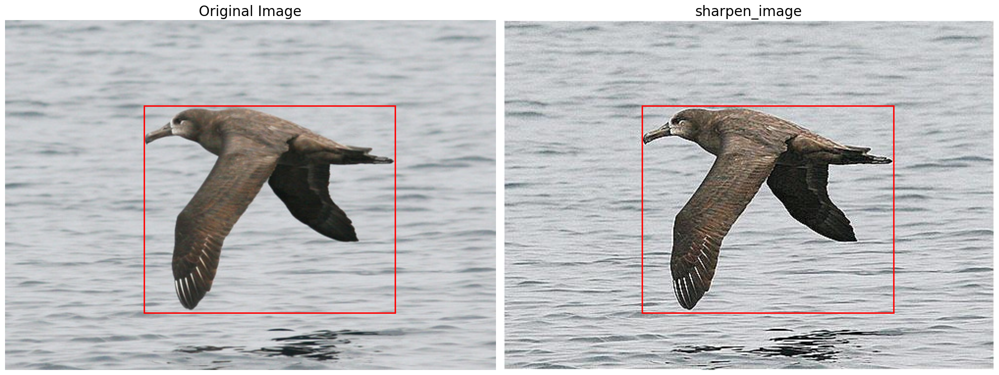

In [286]:
augment_and_display_data(test.iloc[10],sharpen_image)

# Resizeing The image


In [287]:
def resize_image(row , target_size = (255 , 255) ):

    image_path = row['image_dir']
    image = Image.open(image_path)

    original_width, original_height = image.size
    target_width, target_height = target_size

    resized_img = image.resize(target_size, Image.LANCZOS)

    x_scale = target_width / original_width
    y_scale = target_height / original_height

    adjusted_x = row['X_bound_box'] * x_scale
    adjusted_y = row['Y_bound_box'] * y_scale
    adjusted_w = row['width_bound_box'] * x_scale
    adjusted_h = row['height_bound_box'] * y_scale

    new_image_dir = save_image(resized_img, image_path , 'resized_images')
    return new_image_dir, adjusted_x, adjusted_y, adjusted_w, adjusted_h

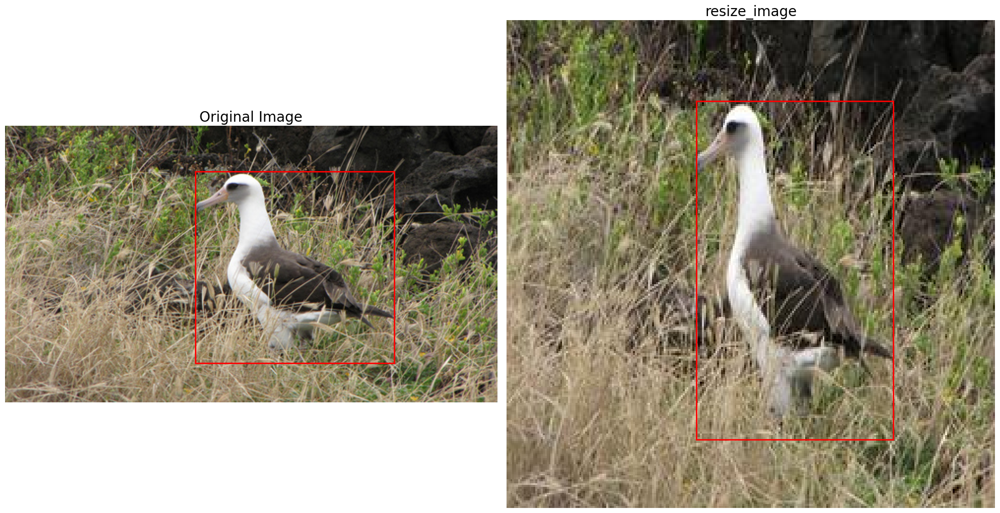

In [288]:
augment_and_display_data(test.iloc[50], resize_image )

# Apply all Augmentations on an Image

In [293]:
def apply_augmentations(row):

    augmentation_paths = {
    'Original Image': row['image_dir'],
    'Horizontal Flip': horizontal_flip(row)[0],
    'Vertical Flip': vertical_flip(row)[0],
    'Rotation': rotate_image(row)[0],
    'Zoom': zoom_in_image(row)[0],
    'Translation': translate_image(row)[0],
    'Noise': gaussian_noise(row)[0],
    'Sharpen': sharpen_image(row)[0]
}


    augmentations = {}
    for title, path in augmentation_paths.items():
        img = Image.open(path)
        augmentations[title] = img


    plt.figure(figsize=(12, 6))

    for i, (title, img) in enumerate(augmentations.items()):
        plt.subplot(2, 4, i + 1)
        plt.imshow(img)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


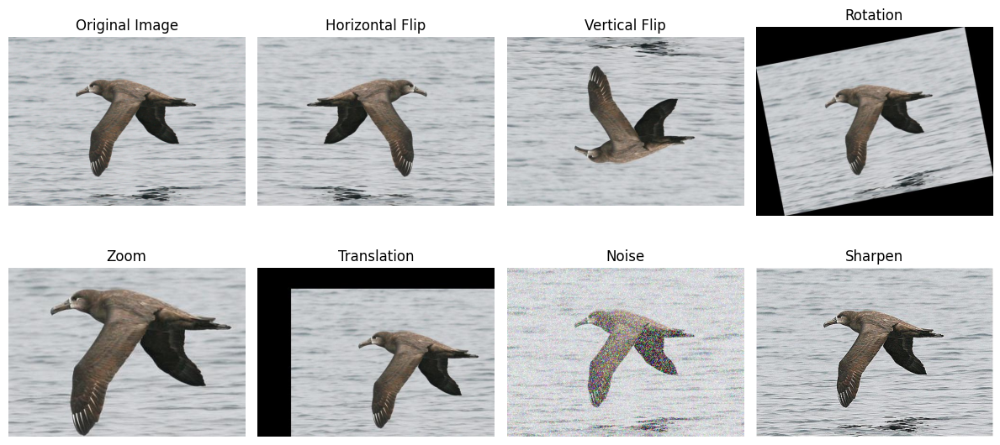

In [294]:
apply_augmentations(test.iloc[10])

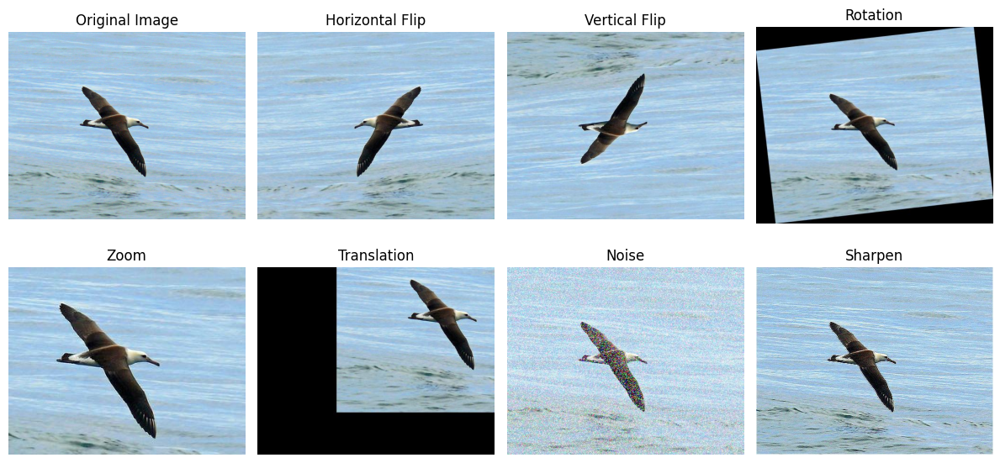

In [295]:
apply_augmentations(test.iloc[66])
